In [1]:
# Import Statements

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import string
import regex as re
import spacy

from nltk.corpus import stopwords
from nltk import word_tokenize
from nltk import FreqDist

import warnings
warnings.filterwarnings('ignore')

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.naive_bayes import MultinomialNB, GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import recall_score, accuracy_score, f1_score, confusion_matrix, classification_report
from sklearn.utils import class_weight
from sklearn.pipeline import Pipeline
from sklearn.base import TransformerMixin
from sklearn import set_config
from sklearn.utils.class_weight import compute_class_weight

from PIL import Image
from wordcloud import WordCloud
from textwrap import wrap

import joblib

In [2]:
# Read the DataFrame created in the Data Collection notebook 
df = pd.read_csv('/Users/lianaavagyan/Desktop/capstone/cities_df', index_col=0)
df.head()

,Attraction,City
0,Royal Opera House,"London, United Kingdom"
1,HMS Belfast,"London, United Kingdom"
2,London Underground,"London, United Kingdom"
3,Tottenham Hotspur Stadium Tour,"London, United Kingdom"
4,Frameless,"London, United Kingdom"


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 17668 entries, 0 to 1199
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Attraction  17668 non-null  object
 1   City        17668 non-null  object
dtypes: object(2)
memory usage: 414.1+ KB


In [4]:
df.describe()

,Attraction,City
count,17668,17668
unique,16409,12
top,Desert Safari Dubai,"Istanbul, Turkey"
freq,9,1680


In [5]:
df.shape

(17668, 2)

In [6]:
#No null values because I scraped everything myself. Just to double-check:
df.isna().sum()

Attraction    0
City          0
dtype: int64

#### Duplicates

In [7]:
df.duplicated().sum()

1200

In [8]:
# Look at duplicates in one city
df[(df.duplicated()==True) & (df['City']=='London, United Kingdom')]

,Attraction,City
311,SingEasy West-End,"London, United Kingdom"
925,Holy Trinity Church,"London, United Kingdom"
938,Skates & Ladders,"London, United Kingdom"
1073,Experience Local Tours,"London, United Kingdom"
1074,Liquid History Tours,"London, United Kingdom"
...,...,...
1214,International Friends,"London, United Kingdom"
1222,The Boat Show Comedy Club,"London, United Kingdom"
1224,Paseando por Europa,"London, United Kingdom"
1228,The Great Christmas Feast,"London, United Kingdom"


In [9]:
# What about the top attraction?
df[df['Attraction']=='Desert Safari Dubai']

,Attraction,City
60,Desert Safari Dubai,"Dubai, United Arab Emirates"
73,Desert Safari Dubai,"Dubai, United Arab Emirates"
132,Desert Safari Dubai,"Dubai, United Arab Emirates"
164,Desert Safari Dubai,"Dubai, United Arab Emirates"
216,Desert Safari Dubai,"Dubai, United Arab Emirates"
335,Desert Safari Dubai,"Dubai, United Arab Emirates"
336,Desert Safari Dubai,"Dubai, United Arab Emirates"
742,Desert Safari Dubai,"Dubai, United Arab Emirates"
757,Desert Safari Dubai,"Dubai, United Arab Emirates"


#### Clearly, there is a need to remove duplicates here, because there are some exact duplicates for certain cities.

In [10]:
df = df.drop_duplicates()

In [11]:
df.shape

(16468, 2)

#### Class Imbalance

In [12]:
display(df.City.unique())
print('Total Unique Cities:', len(df.City.unique()))

array(['London, United Kingdom', 'Paris, France', 'Crete, Greece',
       'Bali, Indonesia', 'Rome, Italy', 'Phuket, Thailand',
       'Sicily, Italy', 'Majorca, Balearic Islands', 'Barcelona, Spain',
       'Istanbul, Turkey', 'Dubai, United Arab Emirates',
       'Vienna, Austria'], dtype=object)

Total Unique Cities: 12


In [13]:
df.City.value_counts(normalize=True)

City
Paris, France                  0.098069
London, United Kingdom         0.094061
Istanbul, Turkey               0.092361
Bali, Indonesia                0.092118
Sicily, Italy                  0.091025
Dubai, United Arab Emirates    0.090357
Barcelona, Spain               0.086228
Rome, Italy                    0.086046
Phuket, Thailand               0.082220
Vienna, Austria                0.067829
Majorca, Balearic Islands      0.062181
Crete, Greece                  0.057505
Name: proportion, dtype: float64

In [14]:
cities = df.groupby('City').count()

In [15]:
cities.reset_index(inplace=True)

In [16]:
sorted_cities = cities.sort_values(by='Attraction', ascending=False)
sorted_cities

,City,Attraction
7,"Paris, France",1615
5,"London, United Kingdom",1549
4,"Istanbul, Turkey",1521
0,"Bali, Indonesia",1517
10,"Sicily, Italy",1499
3,"Dubai, United Arab Emirates",1488
1,"Barcelona, Spain",1420
9,"Rome, Italy",1417
8,"Phuket, Thailand",1354
11,"Vienna, Austria",1117


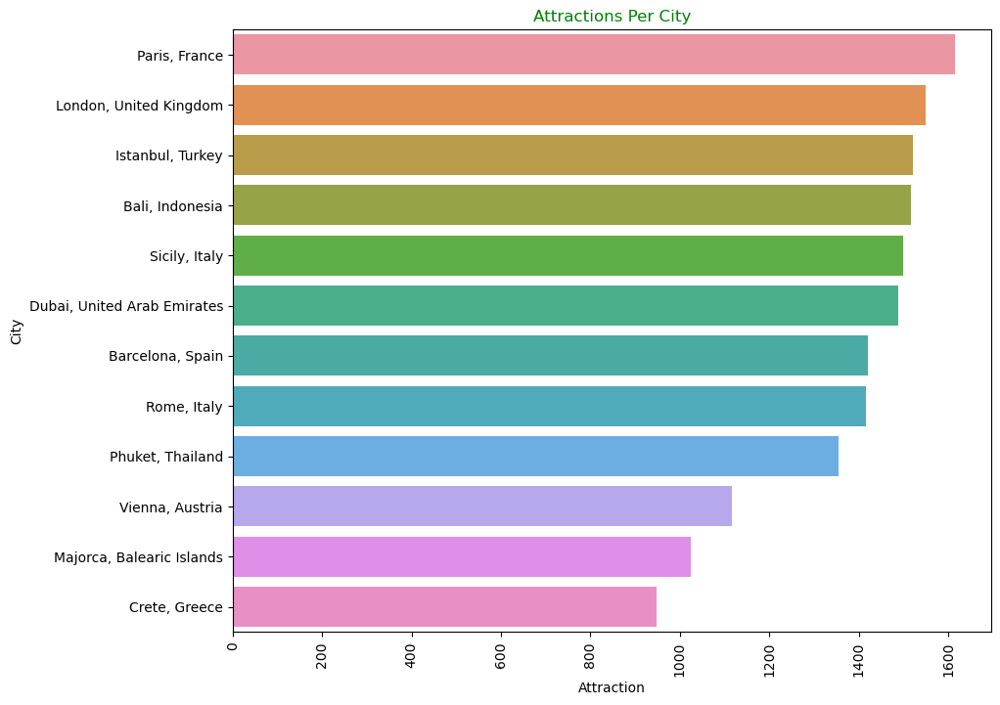

In [17]:
# Plot the class imbalance
plt.figure(figsize=(10,8))
sns.barplot(x='Attraction', y='City', data=sorted_cities)
plt.title('Attractions Per City', color='green')
plt.xticks(rotation=90)
plt.show()

#### This will likely be an issue when modeling, so we will try to use class weights to fix this problem.

### Text Cleaning & Preprocessing & More Exploration

####  - Removing punctuation and numbers
####  - Lowercasing everything
####  - Removing stopwords
####  - Creating a document term matrix grouped by city
####  - count vectorization
####  - tf-idf vectorization
####  - bi-grams
####  - Visualizing most frequent words
####  - word clouds
####  - bar plot/histogram

In [18]:
# Creating a list of stopwords
stopwords_list = stopwords.words('english')
stopwords_list += list(string.punctuation)

In [19]:
# Previewing the list
stopwords_list[:10]

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

In [20]:
# Saving stopwords list for app
joblib.dump(stopwords_list, '/Users/lianaavagyan/Desktop/capstone/stopwords_list')

['/Users/lianaavagyan/Desktop/capstone/stopwords_list']

In [21]:
# Lowercasing all words in each corpus
df['cleaned'] = df['Attraction'].apply(lambda x: x.lower())
df.head()

,Attraction,City,cleaned
0,Royal Opera House,"London, United Kingdom",royal opera house
1,HMS Belfast,"London, United Kingdom",hms belfast
2,London Underground,"London, United Kingdom",london underground
3,Tottenham Hotspur Stadium Tour,"London, United Kingdom",tottenham hotspur stadium tour
4,Frameless,"London, United Kingdom",frameless


In [22]:
# Removing commas, hyphens, colons, and other punctuation
df['cleaned'] = df['cleaned'].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))
df.head(10)

,Attraction,City,cleaned
0,Royal Opera House,"London, United Kingdom",royal opera house
1,HMS Belfast,"London, United Kingdom",hms belfast
2,London Underground,"London, United Kingdom",london underground
3,Tottenham Hotspur Stadium Tour,"London, United Kingdom",tottenham hotspur stadium tour
4,Frameless,"London, United Kingdom",frameless
5,Museum of Brands,"London, United Kingdom",museum of brands
6,Greenwich Park,"London, United Kingdom",greenwich park
7,Westminster,"London, United Kingdom",westminster
8,National Maritime Museum,"London, United Kingdom",national maritime museum
9,Emirates Stadium Tour and Museum,"London, United Kingdom",emirates stadium tour and museum


In [23]:
# Using regex to get rid of numbers 
df['cleaned'] = df['cleaned'].apply(lambda x: re.sub('\w*\d\w*','', x))
df.head(10)

,Attraction,City,cleaned
0,Royal Opera House,"London, United Kingdom",royal opera house
1,HMS Belfast,"London, United Kingdom",hms belfast
2,London Underground,"London, United Kingdom",london underground
3,Tottenham Hotspur Stadium Tour,"London, United Kingdom",tottenham hotspur stadium tour
4,Frameless,"London, United Kingdom",frameless
5,Museum of Brands,"London, United Kingdom",museum of brands
6,Greenwich Park,"London, United Kingdom",greenwich park
7,Westminster,"London, United Kingdom",westminster
8,National Maritime Museum,"London, United Kingdom",national maritime museum
9,Emirates Stadium Tour and Museum,"London, United Kingdom",emirates stadium tour and museum


In [24]:
# Loading the English language model
nlp = spacy.load('en_core_web_sm')

# Lemmatizing the text using spacy assuming df['cleaned'] contains the text data we want to lemmatize
df['lemmatized'] = df['cleaned'].apply(lambda x: ' '.join([token.lemma_ for token in list(nlp(x)) if (token.is_stop==False)]))
df.head(20)

,Attraction,City,cleaned,lemmatized
0,Royal Opera House,"London, United Kingdom",royal opera house,royal opera house
1,HMS Belfast,"London, United Kingdom",hms belfast,hms belfast
2,London Underground,"London, United Kingdom",london underground,london underground
3,Tottenham Hotspur Stadium Tour,"London, United Kingdom",tottenham hotspur stadium tour,tottenham hotspur stadium tour
4,Frameless,"London, United Kingdom",frameless,frameless
5,Museum of Brands,"London, United Kingdom",museum of brands,museum brand
6,Greenwich Park,"London, United Kingdom",greenwich park,greenwich park
7,Westminster,"London, United Kingdom",westminster,westminster
8,National Maritime Museum,"London, United Kingdom",national maritime museum,national maritime museum
9,Emirates Stadium Tour and Museum,"London, United Kingdom",emirates stadium tour and museum,emirates stadium tour museum


In [25]:
# Groupping the corpora by city and join them
df_to_be_group = df[['City', 'lemmatized']]
df_grouped = df_to_be_group.groupby(by='City').agg(lambda x:' '.join(x))
df_grouped

,lemmatized
City,
"Bali, Indonesia",waterbom bali sacred monkey forest sanctuary t...
"Barcelona, Spain",basílica de la sagrada familia casa batlló got...
"Crete, Greece",fullday private adventure knossos zeus cave ...
"Dubai, United Arab Emirates",dubai fountain burj khalifa atlantis aquaventu...
"Istanbul, Turkey",hagia sophia mosque basilica cistern blue mosq...
"London, United Kingdom",royal opera house hms belfast london undergrou...
"Majorca, Balearic Islands",playa cala gran playa de ses saline formentor ...
"Paris, France",paris ultimate food tour musée d’orsay orsay m...
"Phuket, Thailand",big buddha phuket bangla road green elephant s...


In [26]:
# Saving grouped df
df_grouped.to_csv('/Users/lianaavagyan/Desktop/capstone/df_grouped')

### Looking at different vectorization strategies
#### Trying different vectorization strategies and visualize them with word clouds
#### - count vectorization
#### - tf-idf vectorization
#### - bi-grams

In [27]:
# Creating a document term matrix using count vectorization
# Using count vectorization (most simple way to vectorize)

cv = CountVectorizer(analyzer='word', stop_words=stopwords_list)
data = cv.fit_transform(df_grouped['lemmatized'])
df_dtm = pd.DataFrame(data.toarray(), columns=cv.get_feature_names_out())
df_dtm.index = df_grouped.index
df_dtm

,aaron,ab,abaco,abadi,abandon,abanic,abate,abba,abbasağa,abbazia,...,яхты,ترافل,شركة,ماسترينغ,バリ島,ブルーダイブセンター,ヤスイツアー,专业中文导游子龙哥,공기먹는,다이버스
City,,,,,,,,,,,,,,,,,,,,,
"Bali, Indonesia",0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,1,0,1,0,0,0
"Barcelona, Spain",0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Crete, Greece",0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Dubai, United Arab Emirates",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Istanbul, Turkey",0,0,0,0,0,0,0,0,1,0,...,1,1,1,1,0,0,0,1,0,0
"London, United Kingdom",1,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
"Majorca, Balearic Islands",0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Paris, France",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Phuket, Thailand",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,1


In [28]:
# Creating a document term matrix using TF-IDF vectorization

tfidf = TfidfVectorizer(analyzer='word', stop_words=stopwords_list)
data2 = tfidf.fit_transform(df_grouped['lemmatized'])
df_dtm2 = pd.DataFrame(data2.toarray(), columns=tfidf.get_feature_names_out())
df_dtm2.index = df_grouped.index
df_dtm2

,aaron,ab,abaco,abadi,abandon,abanic,abate,abba,abbasağa,abbazia,...,яхты,ترافل,شركة,ماسترينغ,バリ島,ブルーダイブセンター,ヤスイツアー,专业中文导游子龙哥,공기먹는,다이버스
City,,,,,,,,,,,,,,,,,,,,,
"Bali, Indonesia",0.000000,0.000000,0.000000,0.001982,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.001982,0.000000,0.001982,0.000000,0.000000,0.000000
"Barcelona, Spain",0.000000,0.000000,0.000000,0.000000,0.000000,0.003339,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Crete, Greece",0.000000,0.000000,0.000000,0.000000,0.002107,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Dubai, United Arab Emirates",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Istanbul, Turkey",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.003933,0.000000,...,0.003933,0.003933,0.003933,0.003933,0.000000,0.000000,0.000000,0.003933,0.000000,0.000000
"London, United Kingdom",0.004726,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004726,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Majorca, Balearic Islands",0.000000,0.000000,0.004501,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Paris, France",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"Phuket, Thailand",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.002467,0.000000,0.000000,0.002467,0.002467


### Word Clouds with Count Vectorization

In [29]:
def generate_wordcloud(data, title):
    cloud = WordCloud(width=420, height=350, max_words=155, colormap='tab20c').generate_from_frequencies(data)
    plt.figure(figsize=(8,8))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('\n'.join(wrap(title,60)), fontsize=12, color='green')
    plt.show()

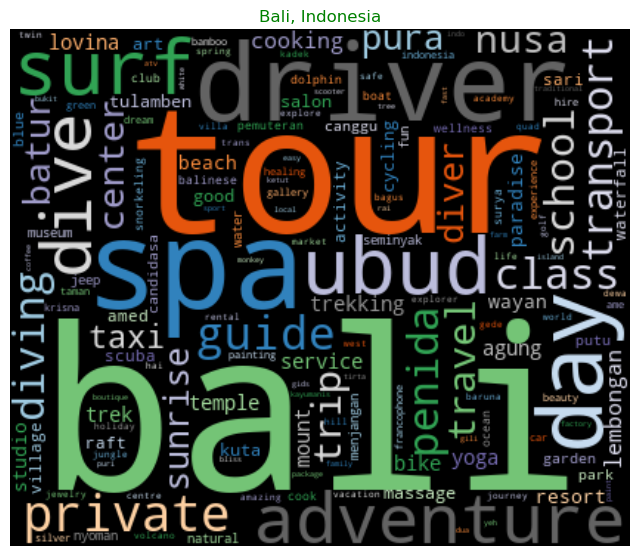

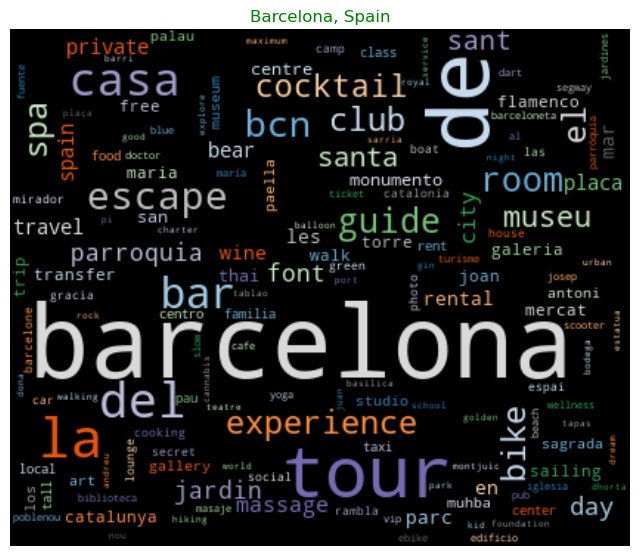

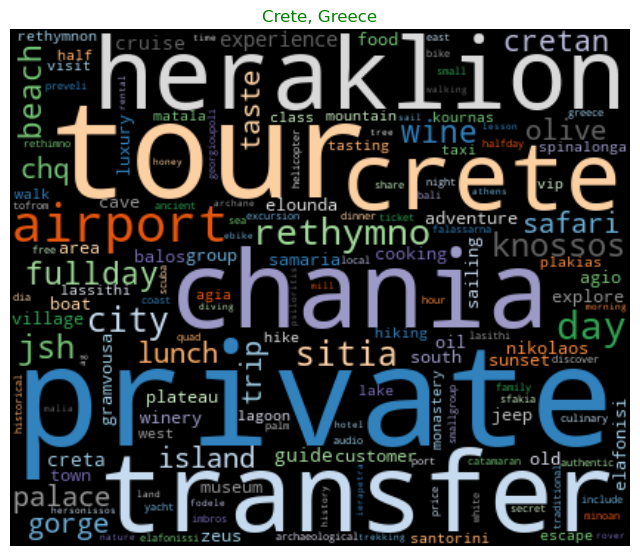

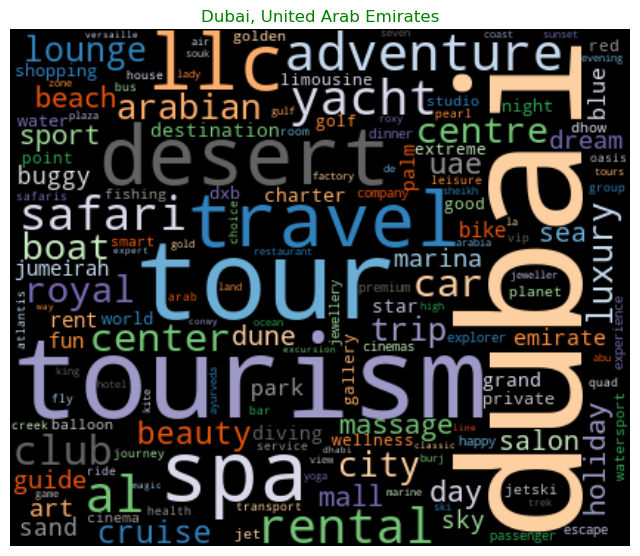

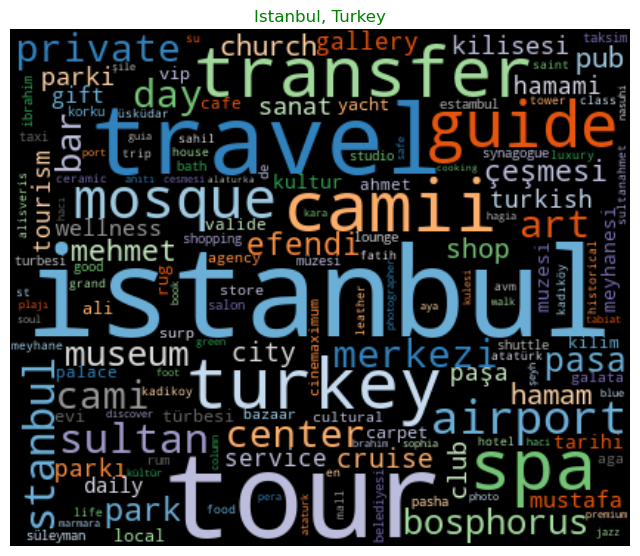

...

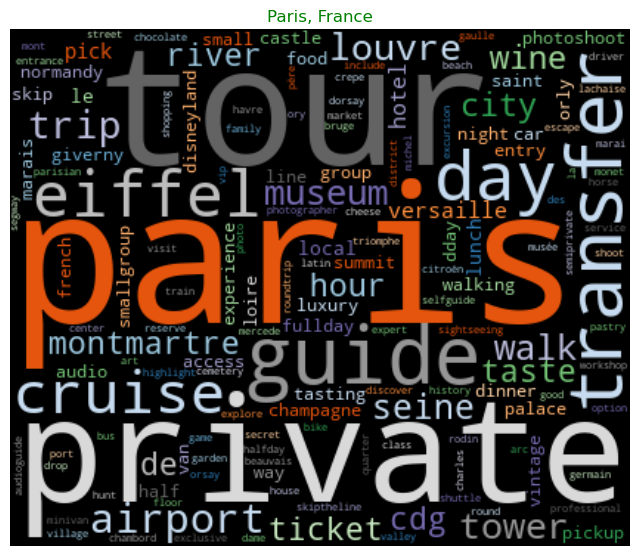

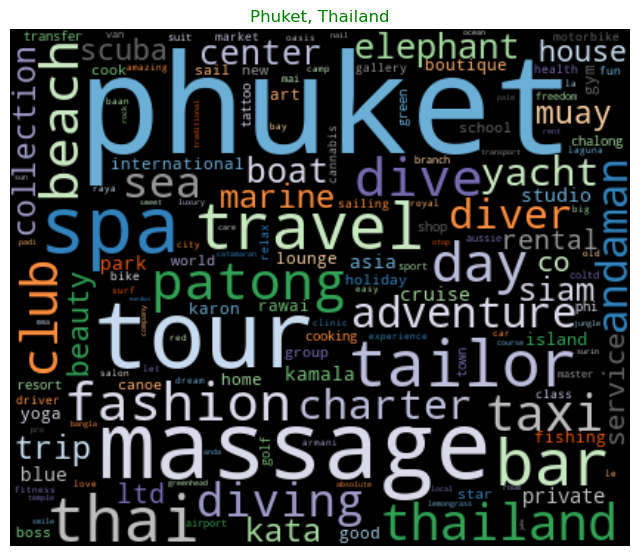

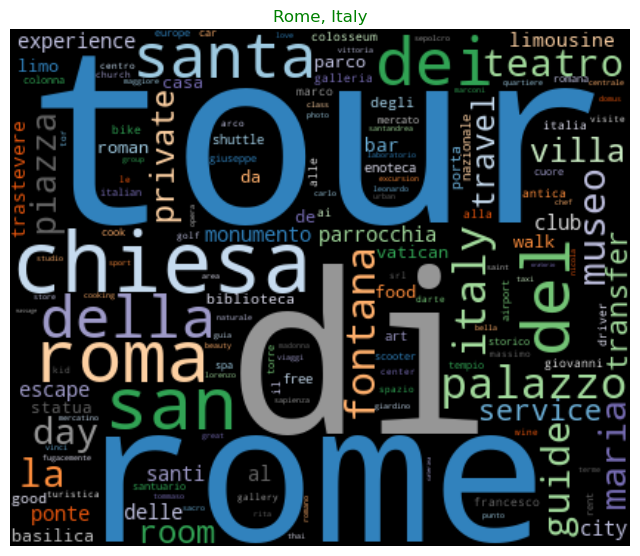

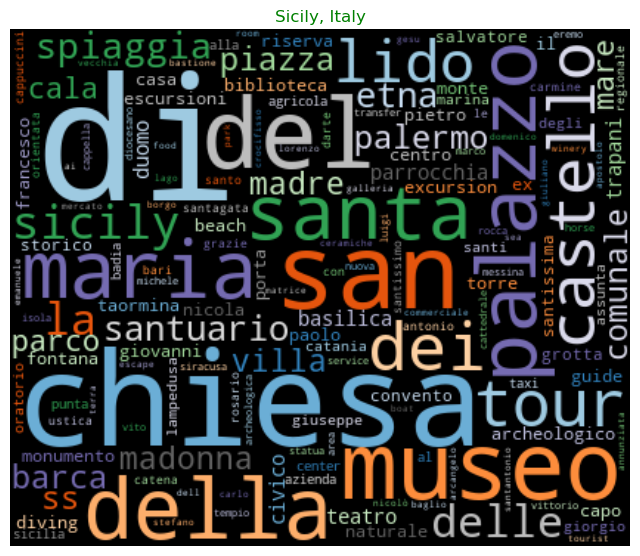

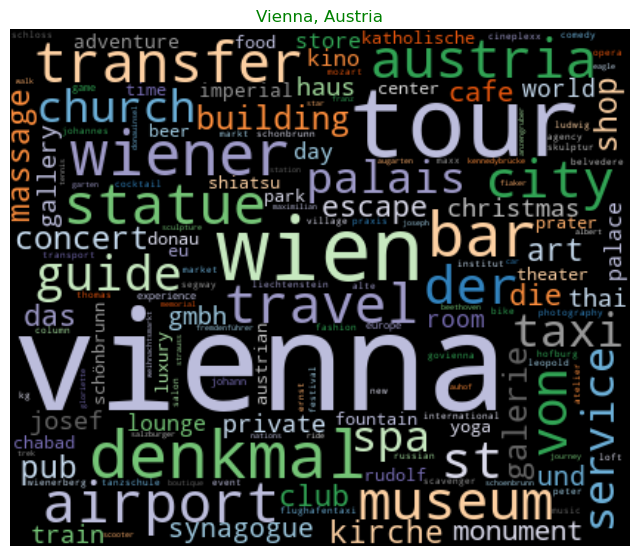

In [30]:
# Transposing document term matrix
df_dtm = df_dtm.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm.columns):
    generate_wordcloud(df_dtm[city].sort_values(ascending=False), city)

In [31]:
# Looking at top words with count vectorizer (in total, not per city)
sum_words = data.sum(axis=0)

In [32]:
words_frequency = [(w, sum_words[0, idx]) for w, idx in cv.vocabulary_.items()]
words_frequency = sorted(words_frequency, key=lambda x: x[1], reverse=True)
words_frequency

[('tour', 2850),
 ('private', 1280),
 ('paris', 1125),
 ('bali', 748),
 ('di', 656),
 ('transfer', 569),
 ('day', 488),
 ('spa', 469),
 ('guide', 465),
 ('airport', 410),
 ('de', 400),
 ('phuket', 378),
 ('travel', 345),
 ('dubai', 325),
 ('chiesa', 320),
 ('barcelona', 311),
 ('city', 284),
 ('bar', 256),
 ('trip', 250),
 ('del', 243),
 ('cruise', 234),
 ('tourism', 227),
 ('london', 219),
 ('san', 217),
 ('museum', 214),
 ('chania', 213),
 ('heraklion', 211),
 ('la', 209),
 ('rome', 209),
 ('massage', 208),
 ('mallorca', 205),
 ('club', 197),
 ('istanbul', 197),
 ('adventure', 195),
 ('crete', 194),
 ('walk', 176),
 ('beach', 174),
 ('wine', 174),
 ('vienna', 161),
 ('experience', 156),
 ('eiffel', 151),
 ('museo', 146),
 ('center', 145),
 ('boat', 145),
 ('driver', 144),
 ('santa', 142),
 ('art', 140),
 ('taxi', 129),
 ('park', 129),
 ('tower', 129),
 ('della', 128),
 ('taste', 127),
 ('escape', 126),
 ('palazzo', 123),
 ('bike', 122),
 ('car', 121),
 ('maria', 118),
 ('louvre', 115

#### There seems to be a lot of repetition with words like 'tour', 'private', 'transfer' between cities because all of these cities will have airport transfers, and different tours. 
#### However, these words will not help in modeling since they are not unique to the cities.

### Word Clouds with TF-IDF Vectorization

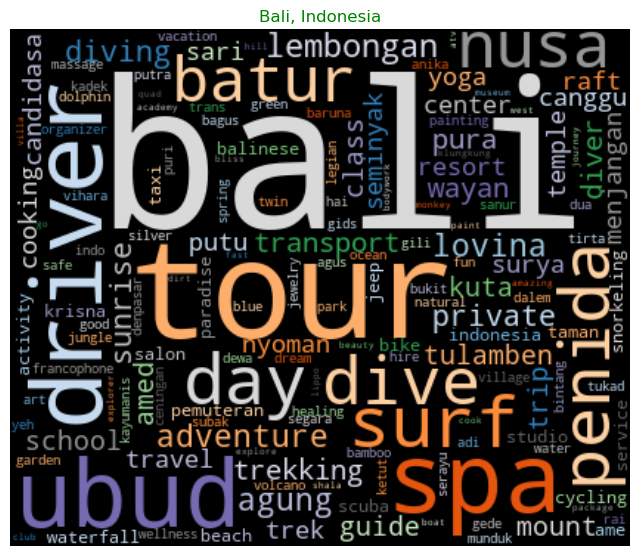

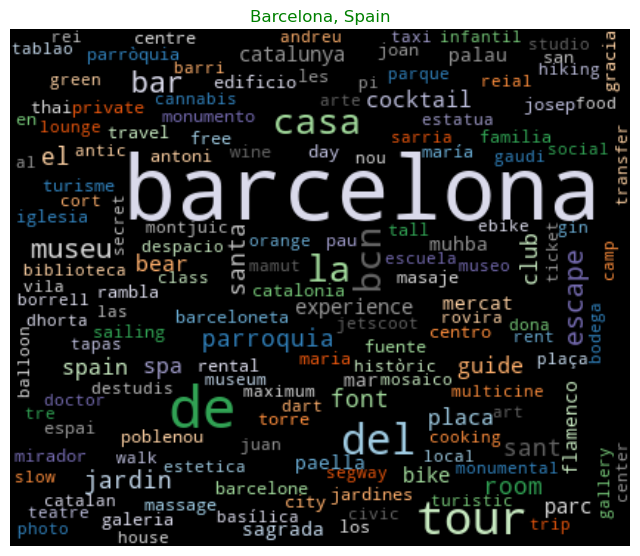

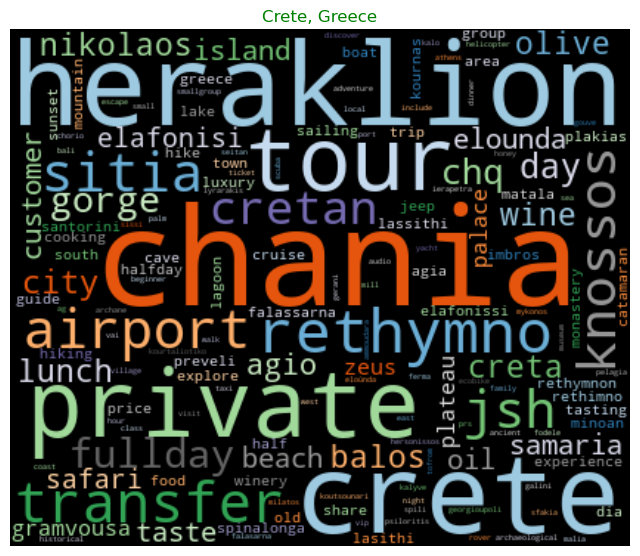

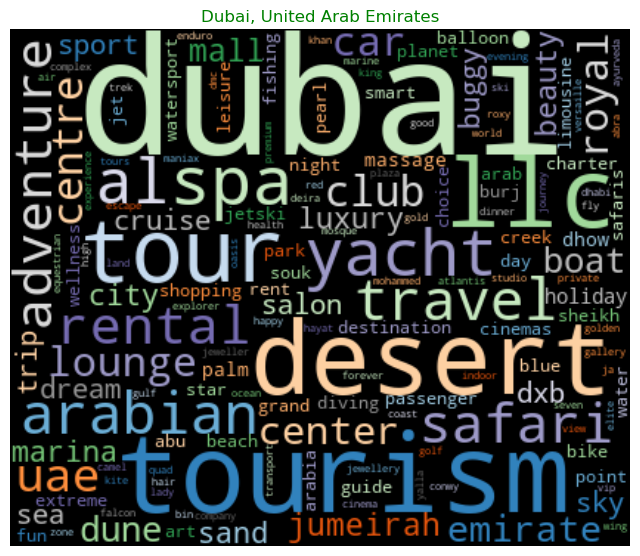

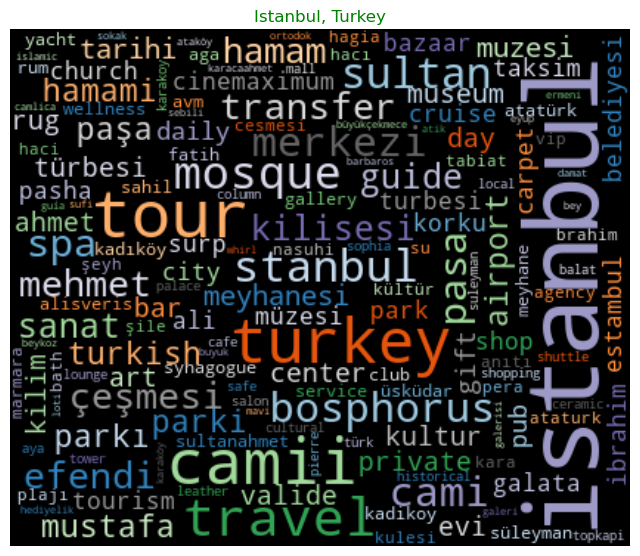

...

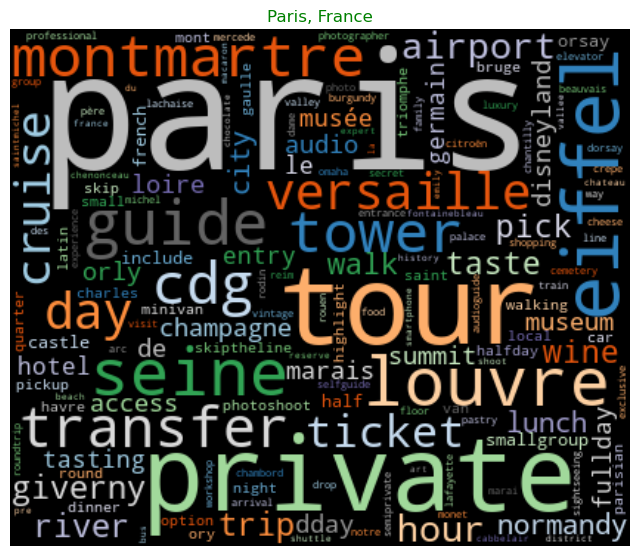

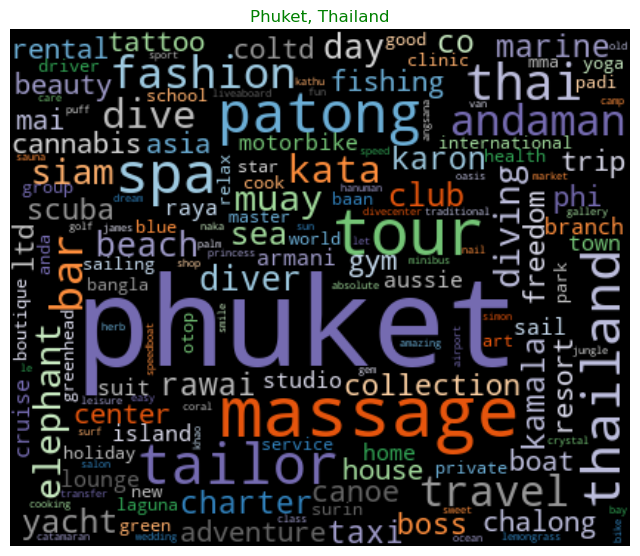

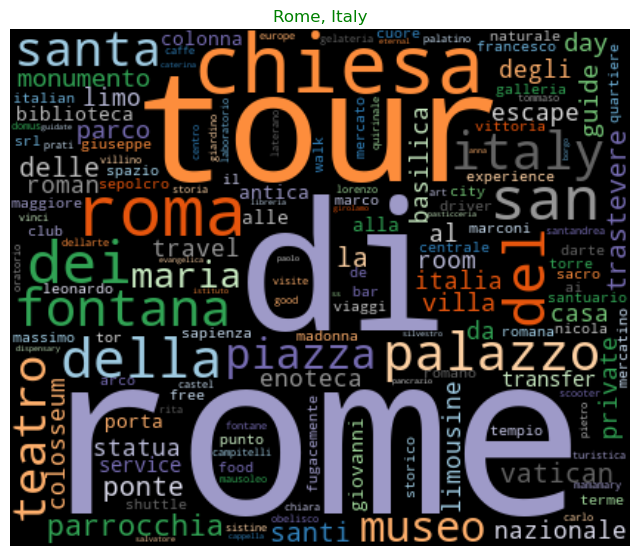

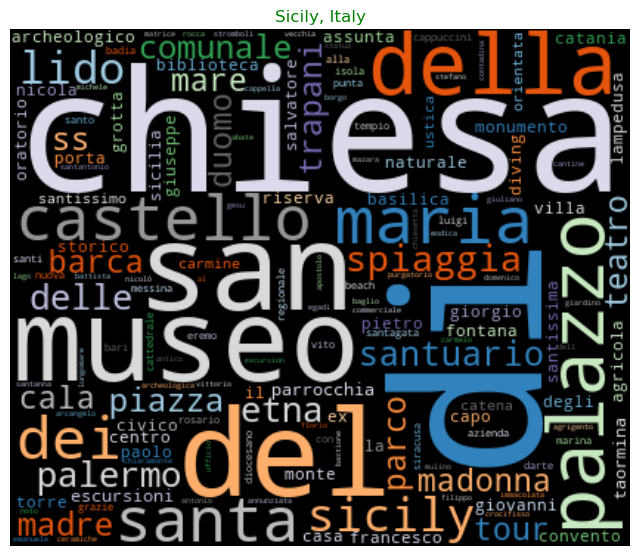

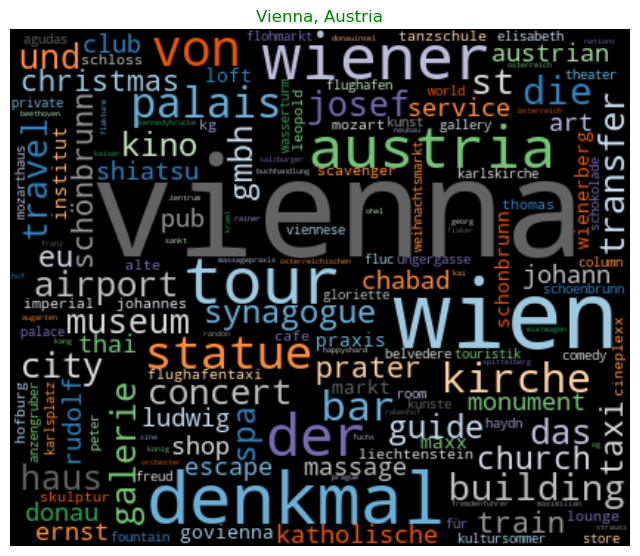

In [33]:
# Transposing document term matrix
df_dtm2 = df_dtm2.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm2.columns):
    generate_wordcloud(df_dtm2[city].sort_values(ascending=False), city)

In [34]:
# Looking at top words with tf-idf vectorization (for total words, not per city)

sum_words = data2.sum(axis=0)
words_frequency = [(w, sum_words[0, idx]) for w, idx in tfidf.vocabulary_.items()]
words_frequency = sorted(words_frequency, key=lambda x: x[1], reverse=True)
words_frequency

[('tour', 2.329525031913421),
 ('di', 1.0287150058047094),
 ('phuket', 0.9326440274070318),
 ('mallorca', 0.9227719203088806),
 ('bali', 0.9186699596529668),
 ('barcelona', 0.8896911188151123),
 ('paris', 0.8523445664864496),
 ('dubai', 0.836244167800553),
 ('vienna', 0.8324381876648487),
 ('london', 0.7806722990815316),
 ('istanbul', 0.7747591563014307),
 ('chiesa', 0.757434247371412),
 ('private', 0.7054351817911132),
 ('rome', 0.6736913567986603),
 ('spa', 0.523418395928188),
 ('del', 0.49609678067257),
 ('de', 0.47393776225196976),
 ('chania', 0.44887681746797664),
 ('heraklion', 0.4446620116701553),
 ('transfer', 0.42948391328627256),
 ('crete', 0.40883616238867354),
 ('travel', 0.3896912422506969),
 ('san', 0.38268963756526253),
 ('bar', 0.35868365627669413),
 ('day', 0.34700985709199816),
 ('guide', 0.3446702740076936),
 ('airport', 0.3335818686567646),
 ('statue', 0.32417830847494356),
 ('tourism', 0.3130398224059346),
 ('wien', 0.3081749827153735),
 ('della', 0.306610389187930

#### In contrast, there is not as much overlap with these words as in the count vectorization because tf-idf vectorization is finding more words that are unique to the cities. 
#### This tells us that tf-idf vectorization is probably a better vectorization technique to use while modeling in order to best predict the cities.

### Word Clouds with Bi-Grams

In [35]:
cv2 = CountVectorizer(analyzer='word', stop_words=stopwords_list, ngram_range=(2,2))

data3 = cv2.fit_transform(df_grouped['lemmatized'])
df_dtm3 = pd.DataFrame(data3.toarray(), columns=cv2.get_feature_names_out())
df_dtm3.index = df_grouped.index
df_dtm3

,aaron hunter,ab vacanze,abaco mc,abadi bali,abandon chania,abanic cocktail,abate palazzo,abate parco,abate pasticceria,abate torre,...,яхты стамбуле,ترافل master,شركة ماسترينغ,ماسترينغ ترافل,バリ島 bali,ブルーダイブセンター rent,ヤスイツアー bali,专业中文导游子龙哥 hayatibaa,공기먹는 다이버스,다이버스 calypso
City,,,,,,,,,,,,,,,,,,,,,
"Bali, Indonesia",0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,1,0,1,0,0,0
"Barcelona, Spain",0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Crete, Greece",0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Dubai, United Arab Emirates",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Istanbul, Turkey",0,0,0,0,0,0,0,0,0,0,...,1,1,1,1,0,0,0,1,0,0
"London, United Kingdom",1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Majorca, Balearic Islands",0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Paris, France",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Phuket, Thailand",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,1,1


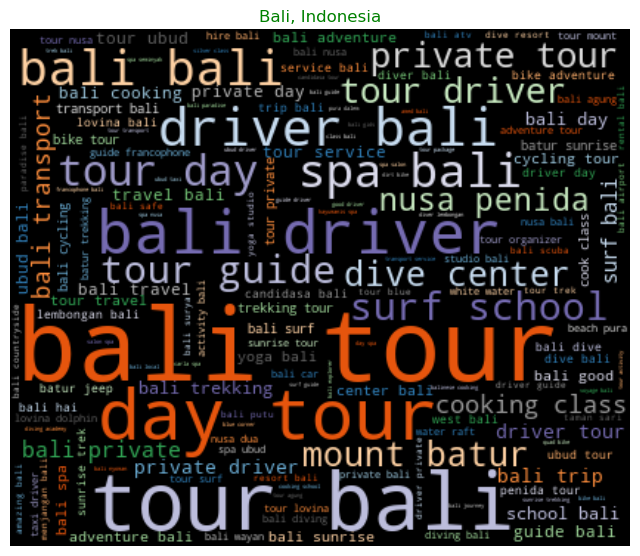

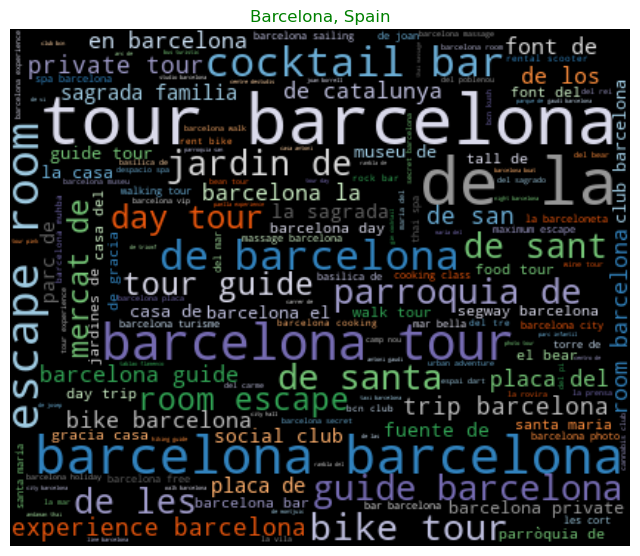

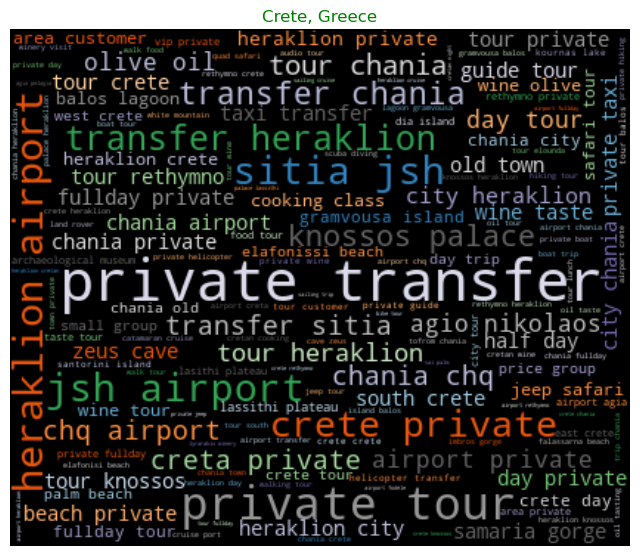

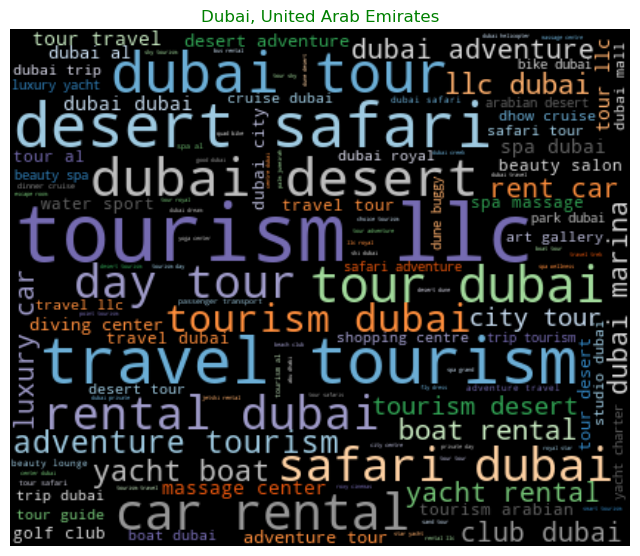

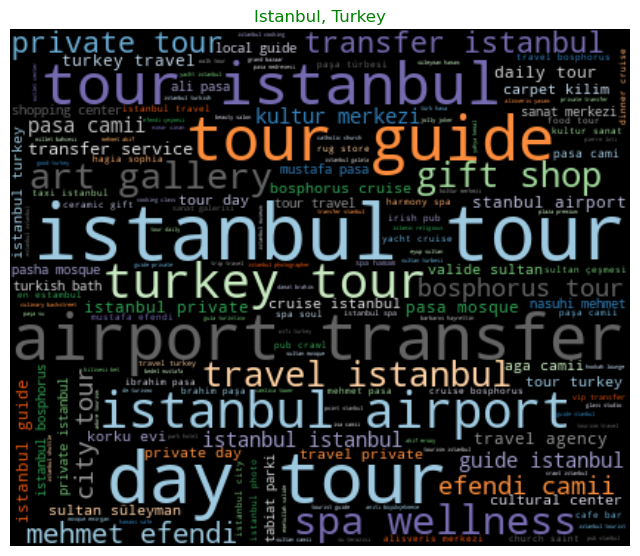

...

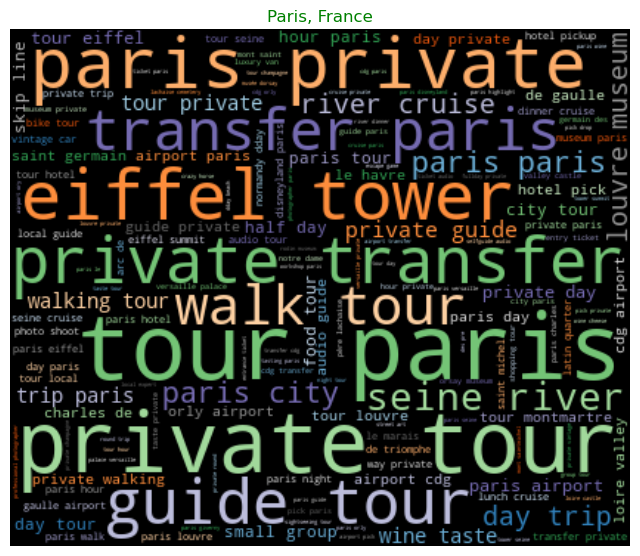

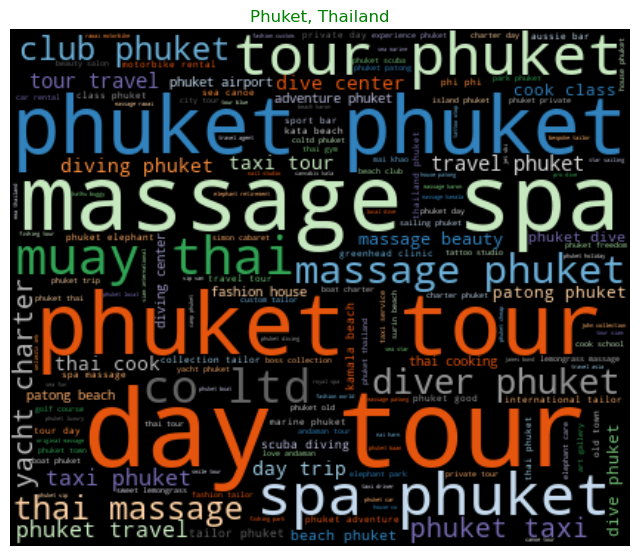

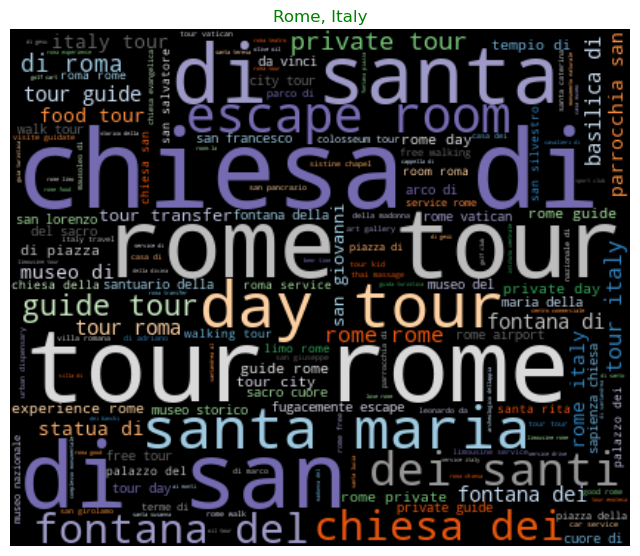

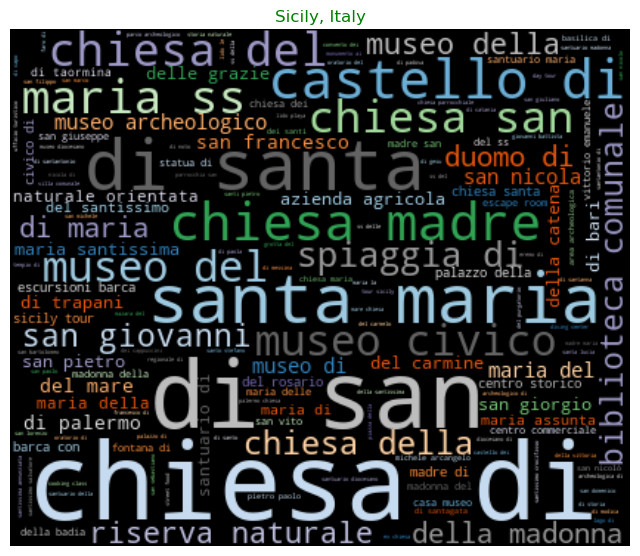

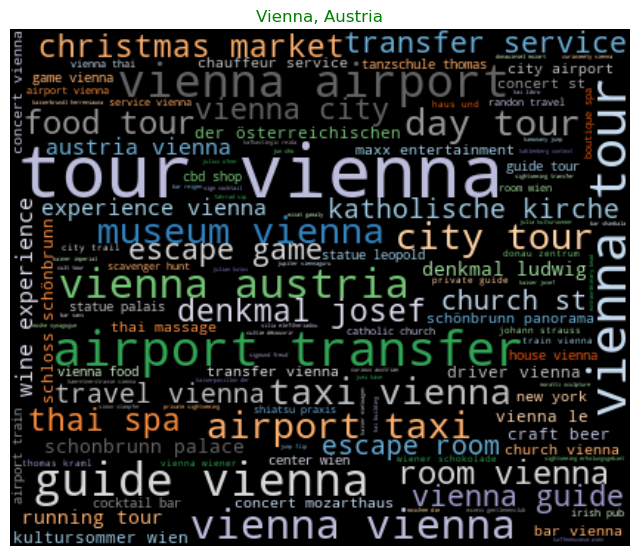

In [36]:
# Transposing document term matrix
df_dtm3 = df_dtm3.transpose()

# Plotting word cloud for each city
for index, city in enumerate(df_dtm3.columns):
    generate_wordcloud(df_dtm3[city].sort_values(ascending=False), city)

In [37]:
# Looking at top bi-grams (in total, not per city)

sum_words = data3.sum(axis=0)
words_frequency = [(w, sum_words[0, idx]) for w, idx in cv2.vocabulary_.items()]
words_frequency = sorted(words_frequency, key=lambda x: x[1], reverse=True)
words_frequency

[('private tour', 316),
 ('private transfer', 265),
 ('day tour', 239),
 ('tour paris', 181),
 ('chiesa di', 173),
 ('bali tour', 152),
 ('guide tour', 140),
 ('di san', 126),
 ('paris private', 117),
 ('eiffel tower', 114),
 ('walk tour', 109),
 ('transfer paris', 96),
 ('tour bali', 91),
 ('di santa', 77),
 ('tour guide', 76),
 ('tour private', 75),
 ('day trip', 72),
 ('santa maria', 72),
 ('heraklion airport', 69),
 ('seine river', 66),
 ('private day', 65),
 ('private guide', 65),
 ('city tour', 65),
 ('sitia jsh', 65),
 ('jsh airport', 65),
 ('wine taste', 63),
 ('crete private', 61),
 ('paris paris', 61),
 ('paris city', 61),
 ('walking tour', 60),
 ('food tour', 60),
 ('escape room', 57),
 ('airport transfer', 56),
 ('tourism llc', 55),
 ('tour day', 54),
 ('tour rome', 54),
 ('transfer heraklion', 52),
 ('river cruise', 52),
 ('louvre museum', 50),
 ('bali driver', 49),
 ('de la', 49),
 ('cooking class', 47),
 ('half day', 47),
 ('rome tour', 47),
 ('bike tour', 45),
 ('transf

#### The bi-grams were able to pick out important terms, such as 'windsor castle' for London, and 'cooking class' for Sicily. 
#### However, words like 'tour' are creating some noise in most of these cities.

## Removing Noise from the Data

#### Since there are still lots of words in the word clouds like 'private', 'airport' and 'transfer', we want to try to take those attractions for airport transfers out because they are causing noise in the data.

In [38]:
df.head(10)

,Attraction,City,cleaned,lemmatized
0,Royal Opera House,"London, United Kingdom",royal opera house,royal opera house
1,HMS Belfast,"London, United Kingdom",hms belfast,hms belfast
2,London Underground,"London, United Kingdom",london underground,london underground
3,Tottenham Hotspur Stadium Tour,"London, United Kingdom",tottenham hotspur stadium tour,tottenham hotspur stadium tour
4,Frameless,"London, United Kingdom",frameless,frameless
5,Museum of Brands,"London, United Kingdom",museum of brands,museum brand
6,Greenwich Park,"London, United Kingdom",greenwich park,greenwich park
7,Westminster,"London, United Kingdom",westminster,westminster
8,National Maritime Museum,"London, United Kingdom",national maritime museum,national maritime museum
9,Emirates Stadium Tour and Museum,"London, United Kingdom",emirates stadium tour and museum,emirates stadium tour museum


In [39]:
# Preview what is going to be dropped

df.loc[df['Attraction'].str.contains('airport')]

,Attraction,City,cleaned,lemmatized
168,Private transfer from Paris or CDG / ORY airpo...,"Paris, France",private transfer from paris or cdg ory airpor...,private transfer paris cdg ory airport versa...
266,Private transfer from PARIS city to CDG or ORY...,"Paris, France",private transfer from paris city to cdg or ory...,private transfer paris city cdg ory airport
450,Private round trip transfer from/to Paris airp...,"Paris, France",private round trip transfer fromto paris airports,private round trip transfer fromto paris airport
472,Private transport from Paris to Charles de Gau...,"Paris, France",private transport from paris to charles de gau...,private transport paris charles de gaulle airport
622,Private transfer from Charles de Gaulle airpor...,"Paris, France",private transfer from charles de gaulle airpor...,private transfer charles de gaulle airport par...
870,Charles de Gaulle airport transfer to Paris hotel,"Paris, France",charles de gaulle airport transfer to paris hotel,charles de gaulle airport transfer paris hotel
932,Beauvais airport shuttle to Paris round trip,"Paris, France",beauvais airport shuttle to paris round trip,beauvais airport shuttle paris round trip
985,Transfer Paris to airport CDG and ORLY 8 pax,"Paris, France",transfer paris to airport cdg and orly pax,transfer paris airport cdg orly pax
1036,Half Day Paris Tour with Pick up from Orly air...,"Paris, France",half day paris tour with pick up from orly air...,half day paris tour pick orly airport
1047,"Luxury and private transfer (Mercedes E), Pari...","Paris, France",luxury and private transfer mercedes e paris f...,luxury private transfer mercede e paris fromto...


In [40]:
# Getting rid of the airport transfer 'attractions'

df2 = df.drop(df.loc[df['Attraction'].str.contains('airport')].index)
df2 = df.drop(df2.loc[df2['Attraction'].str.contains('transfer')].index)

In [41]:
# Adding these words to the stopwords list
stopwords_list += ['airport', 'transfer', 'private']

In [42]:
print(df.shape)
print(df2.shape)

(16468, 4)
(16022, 4)


### Creating some functions to make the preprocessing steps easier

In [43]:
def preprocess_df(df, column, preview = True, lemmatize = True):
    
    df[column] = df['Attraction'].apply(lambda x: x.lower())
    df[column] = df[column].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))
    df[column] = df[column].apply(lambda x: re.sub('\w*\d\w*','', x))
    
    if lemmatize:
        df[column] = df[column].apply(lambda x: ' '.join(
                                        [token.lemma_ for token in list(nlp(x)) if (token.is_stop==False)]))
    if preview:
        display(df.head(10))
        
    return df

In [44]:
def group_text_per_city(df, column):
    
    df_to_group = df[['City', column]]
    df_grouped = df_to_group.groupby(by='City').agg(lambda x:' '.join(x))
    return df_grouped

In [45]:
def create_doc_term_matrix(df, column, count_vec=True, ngram_range=(1,1)):
    
    df_grouped = group_text_per_city(df, column)
    
    if count_vec:
        vec = CountVectorizer(analyzer='word', stop_words=stopwords_list, ngram_range=ngram_range)
    else:
        vec = TfidfVectorizer(analyzer='word', stop_words=stopwords_list)
    
    data = vec.fit_transform(df_grouped[column])
    
    df_dtm = pd.DataFrame(data.toarray(), columns=vec.get_feature_names_out())
    df_dtm.index = df_grouped.index
    return df_dtm.transpose()

,Attraction,City,cleaned,lemmatized
0,Royal Opera House,"London, United Kingdom",royal opera house,royal opera house
1,HMS Belfast,"London, United Kingdom",hms belfast,hms belfast
2,London Underground,"London, United Kingdom",london underground,london underground
3,Tottenham Hotspur Stadium Tour,"London, United Kingdom",tottenham hotspur stadium tour,tottenham hotspur stadium tour
4,Frameless,"London, United Kingdom",frameless,frameless
5,Museum of Brands,"London, United Kingdom",museum of brands,museum brand
6,Greenwich Park,"London, United Kingdom",greenwich park,greenwich park
7,Westminster,"London, United Kingdom",westminster,westminster
8,National Maritime Museum,"London, United Kingdom",national maritime museum,national maritime museum
9,Emirates Stadium Tour and Museum,"London, United Kingdom",emirates stadium tour and museum,emirates stadium tour museum


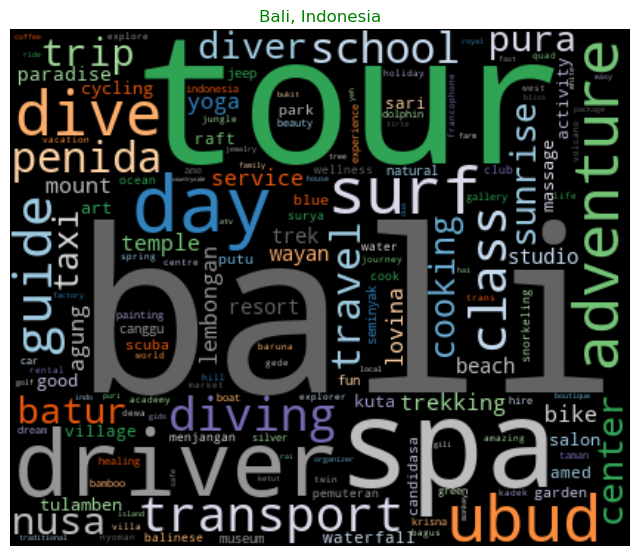

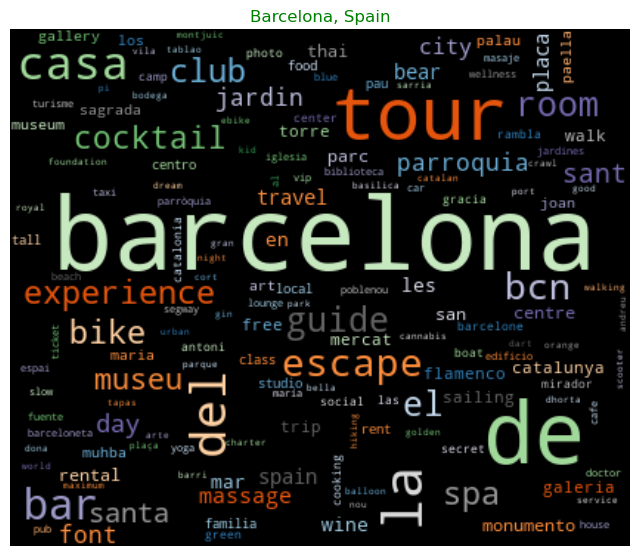

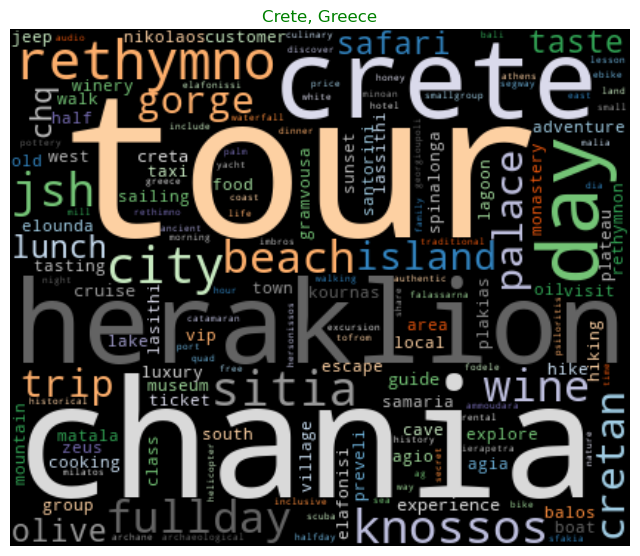

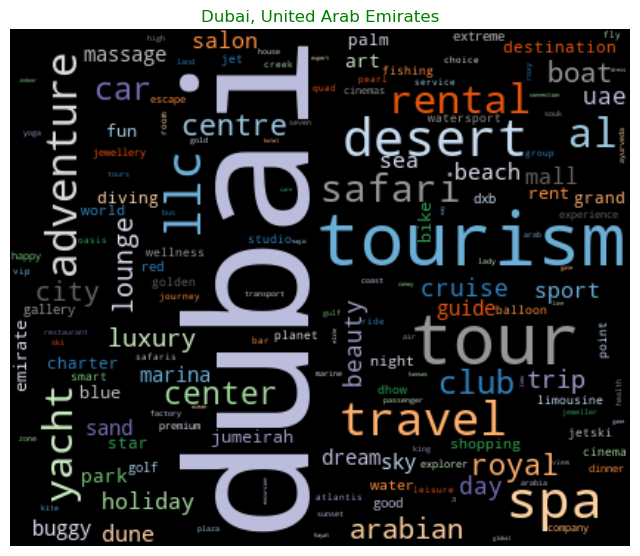

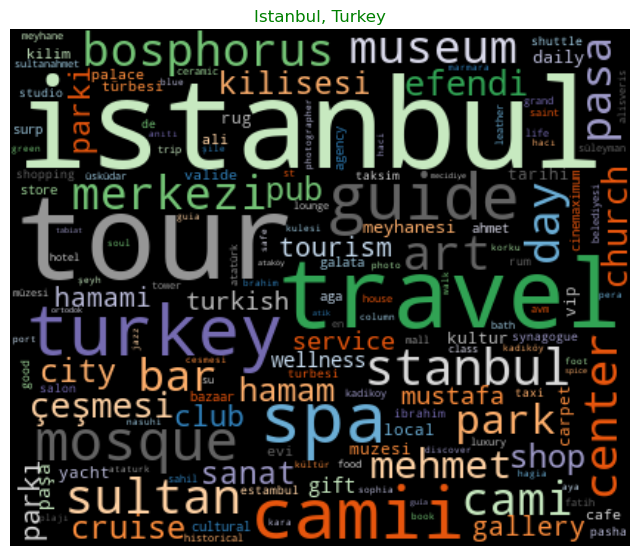

...

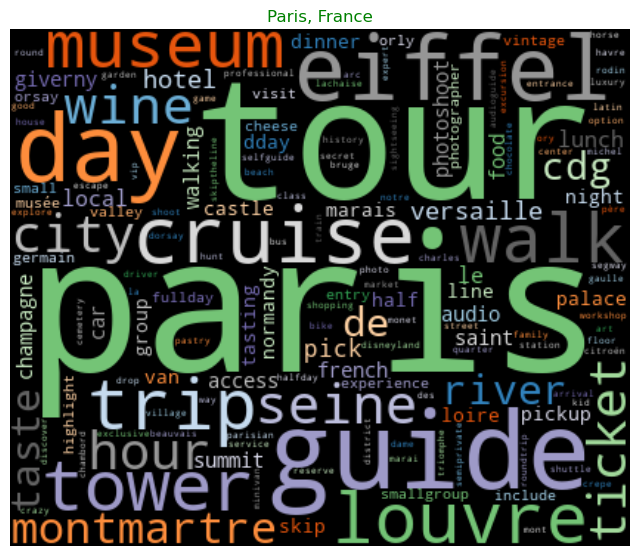

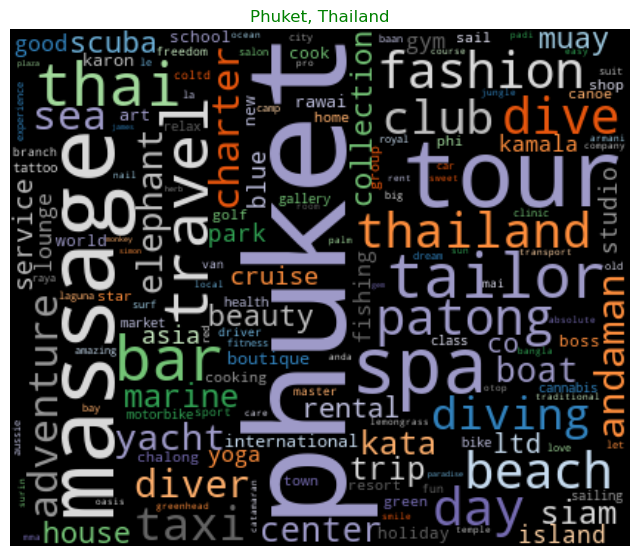

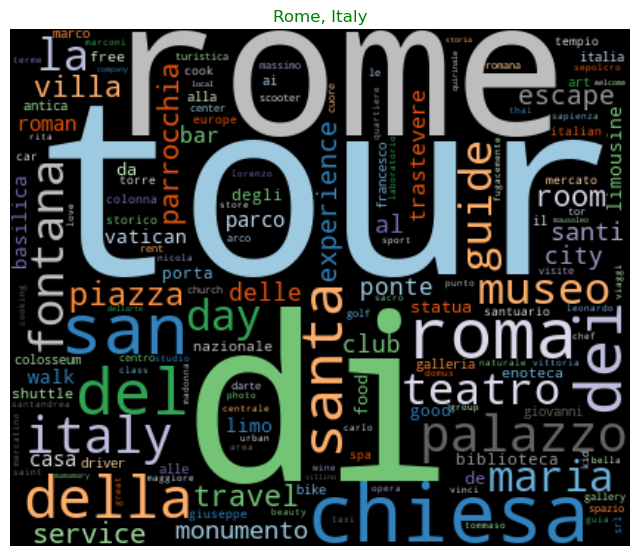

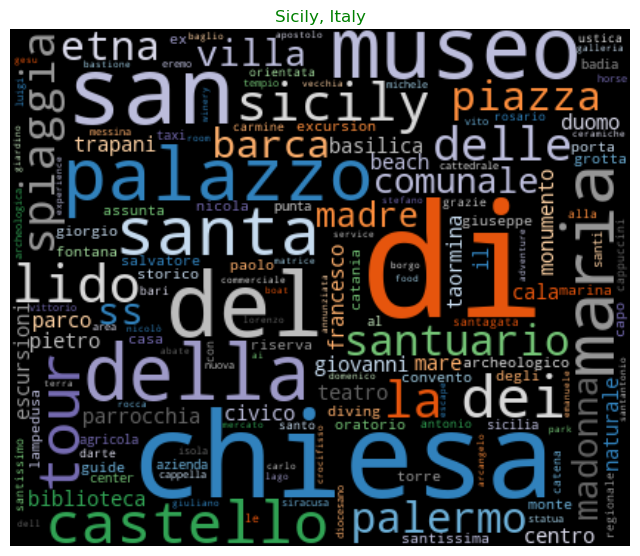

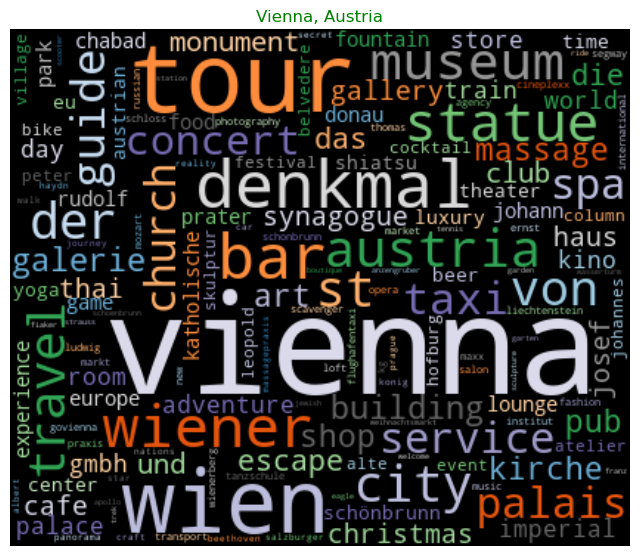

In [46]:
preprocessed_df = preprocess_df(df2, 'lemmatized')
dtm_cv = create_doc_term_matrix(preprocessed_df, 'lemmatized', count_vec=True)

for index, city in enumerate(dtm_cv.columns):
    generate_wordcloud(dtm_cv[city].sort_values(ascending=False), city)

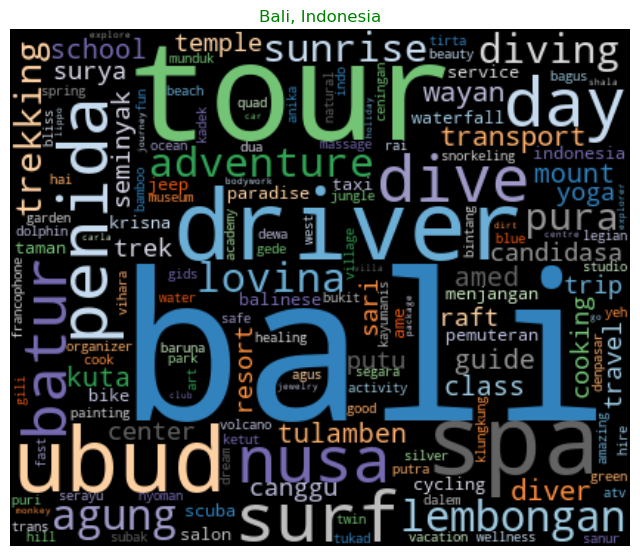

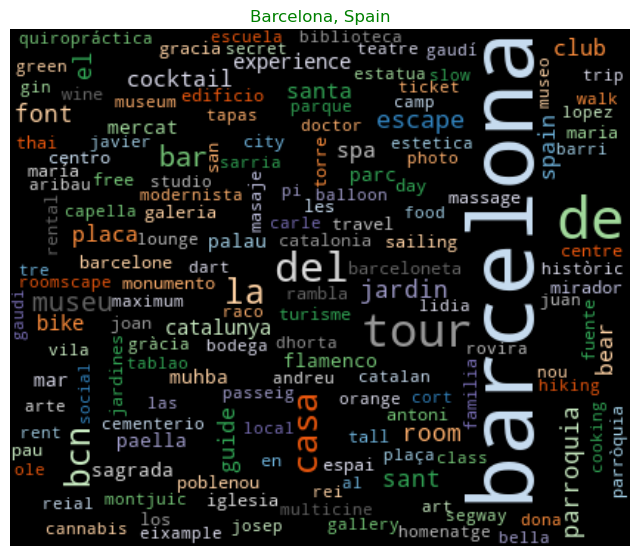

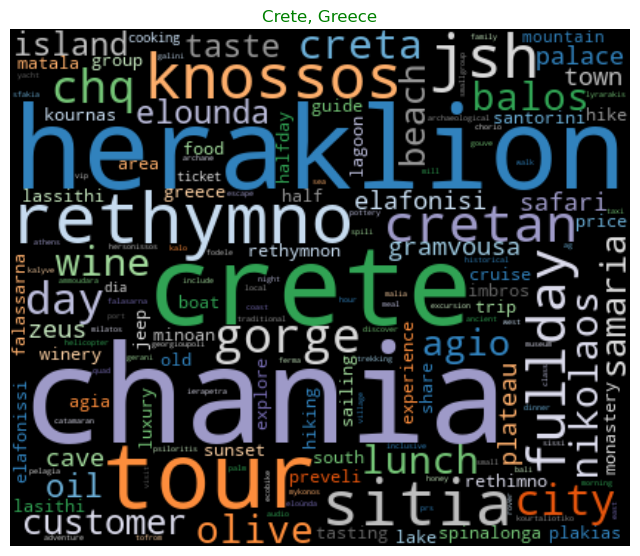

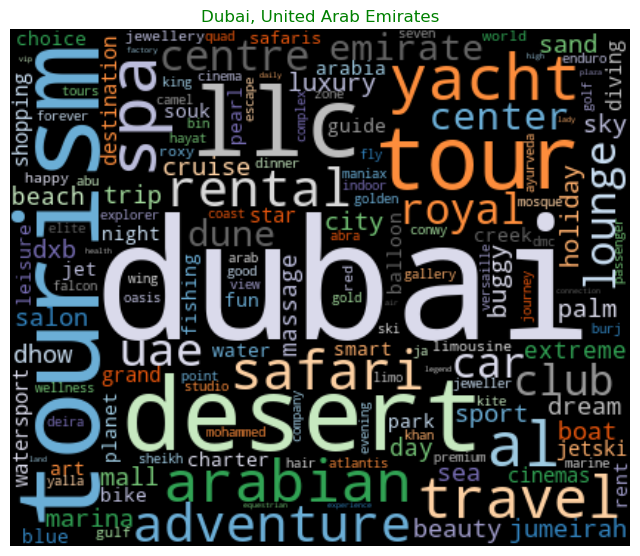

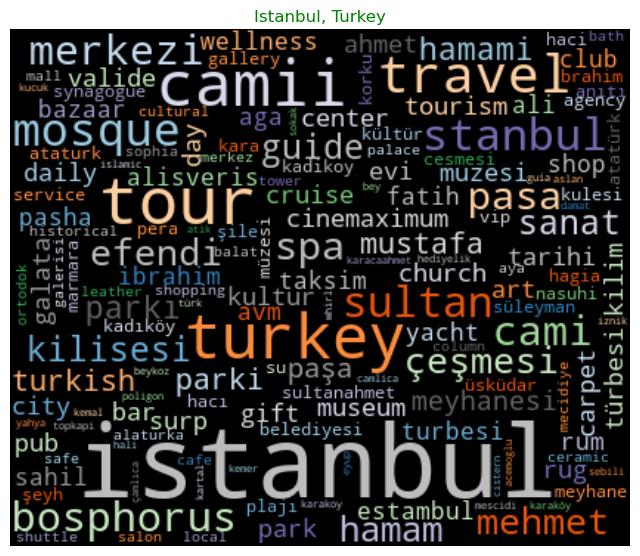

...

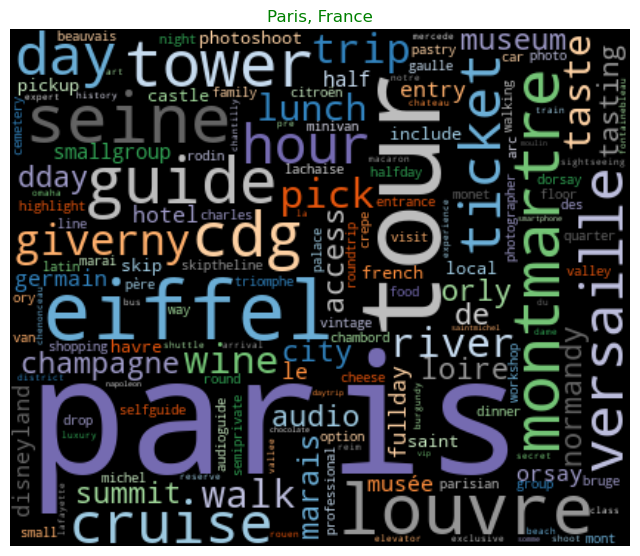

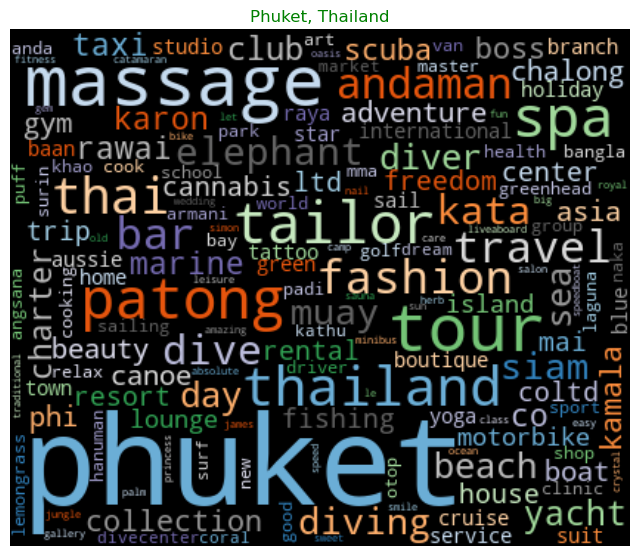

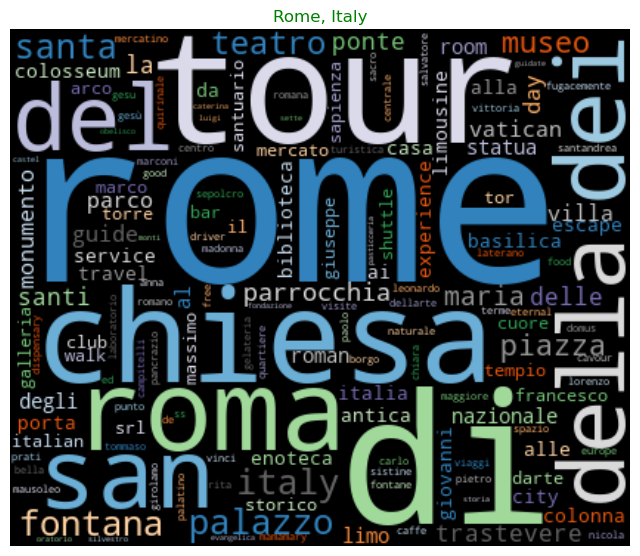

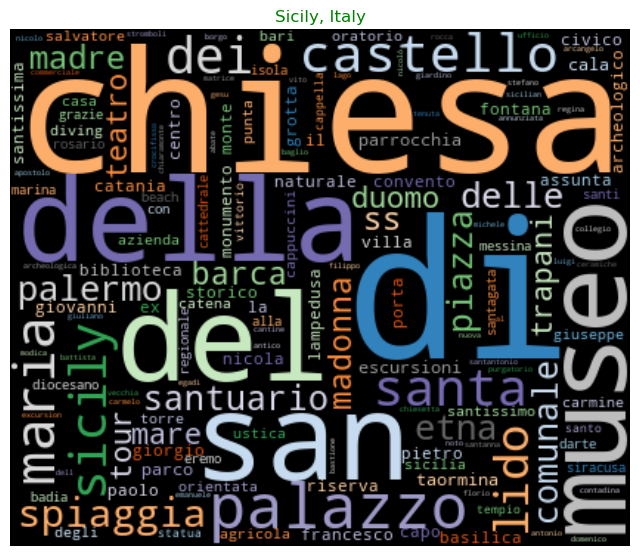

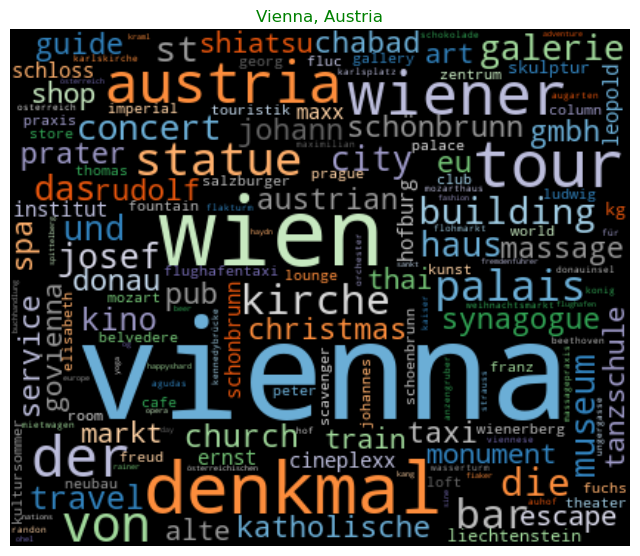

In [47]:
dtm_tfidf = create_doc_term_matrix(df2, 'lemmatized', count_vec = False)

for index, city in enumerate(dtm_tfidf.columns):
    generate_wordcloud(dtm_tfidf[city].sort_values(ascending = False), city)

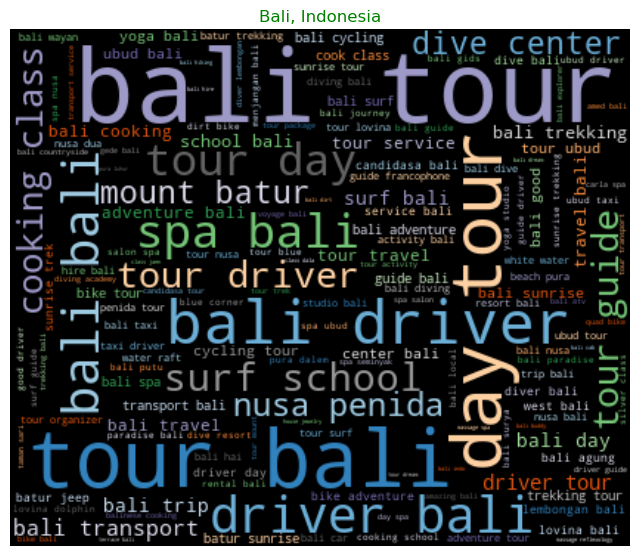

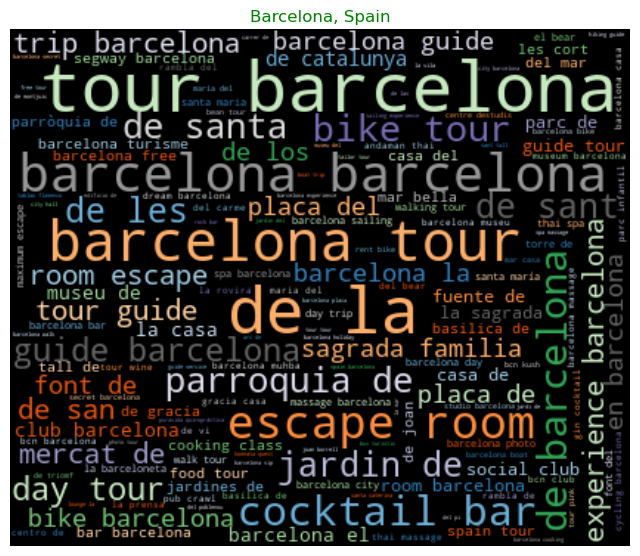

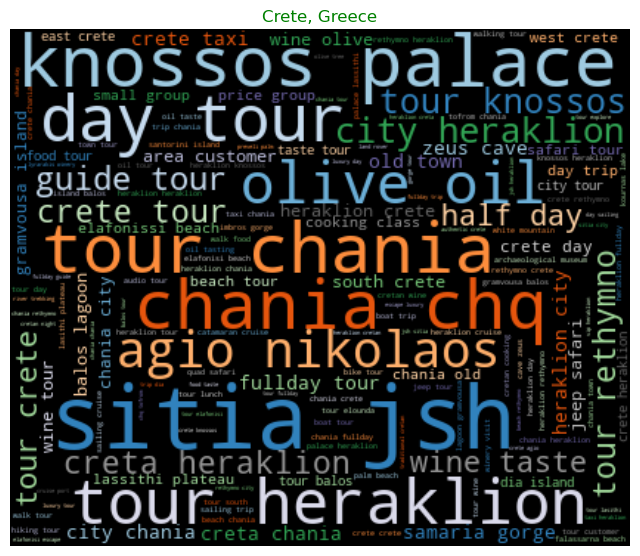

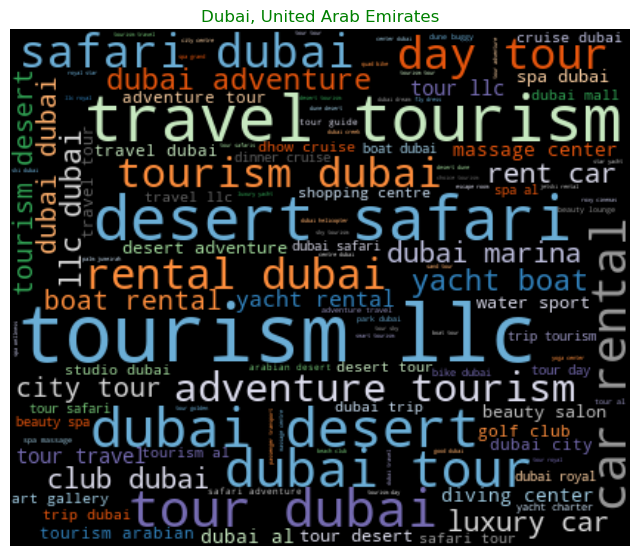

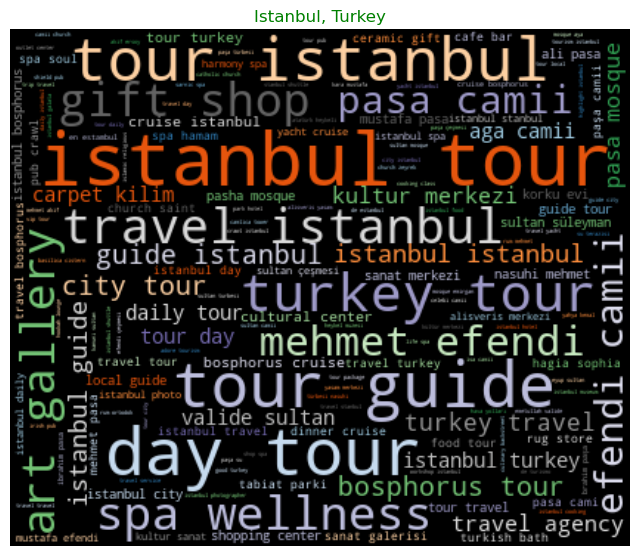

...

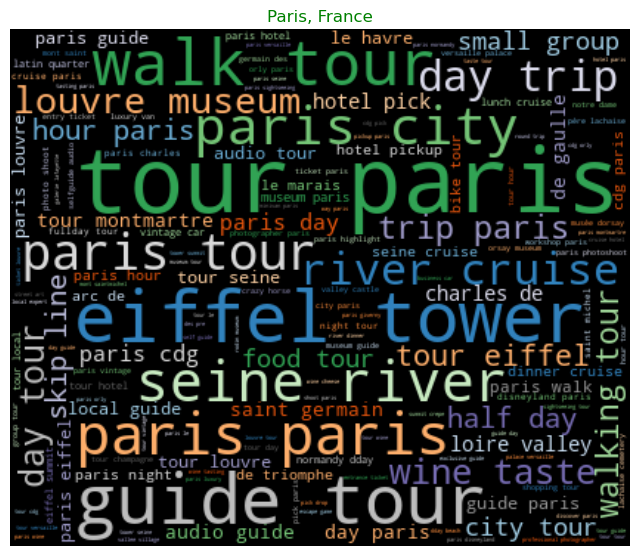

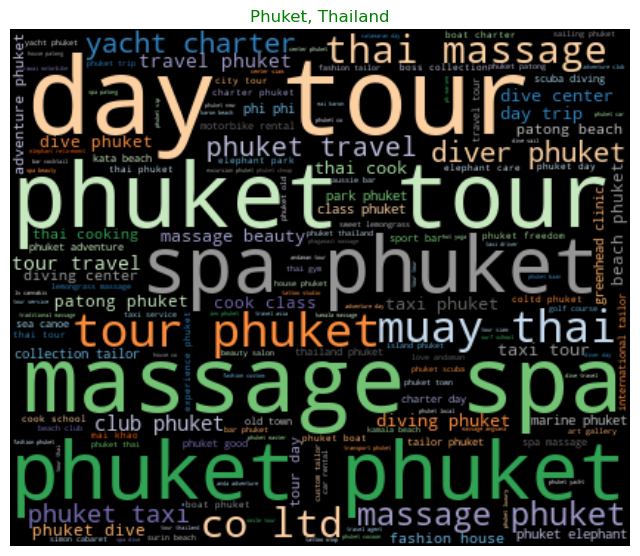

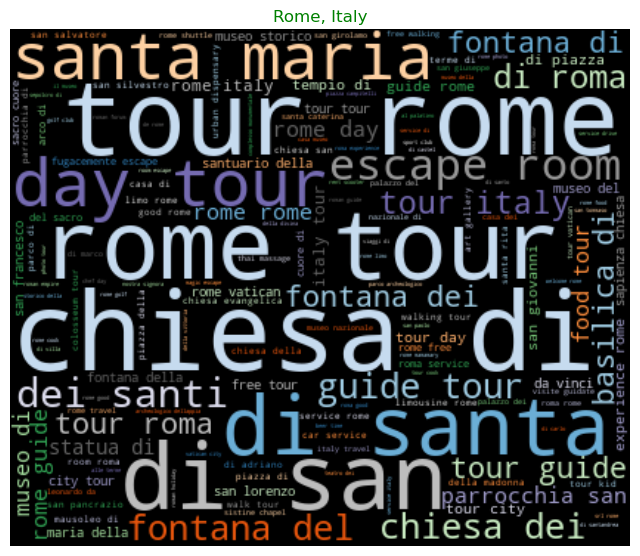

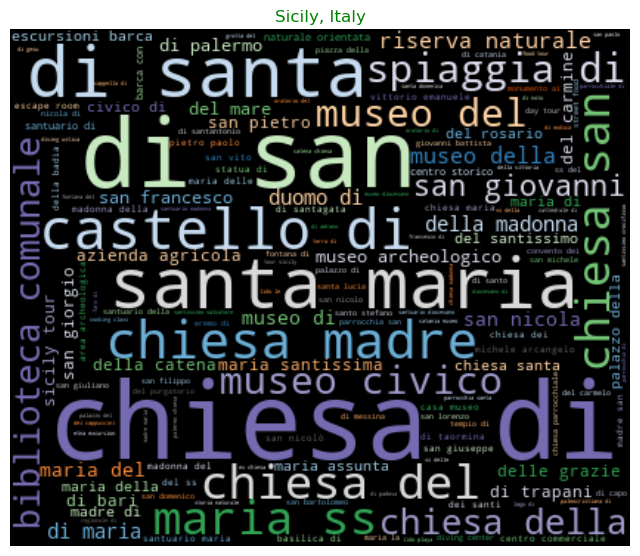

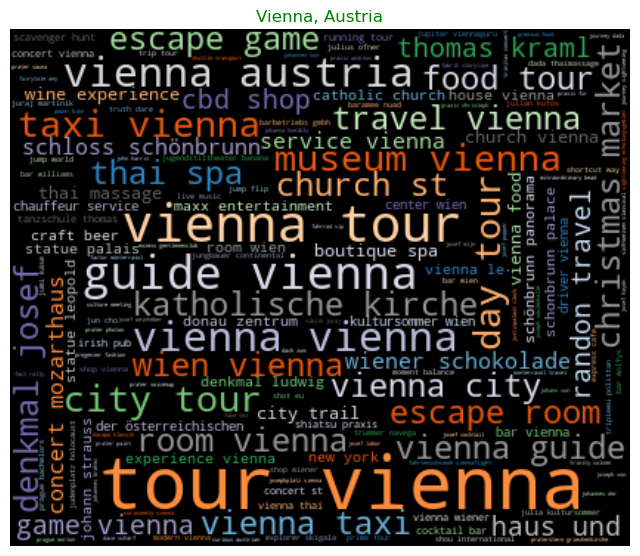

In [48]:
dtm_bigram = create_doc_term_matrix(df2, 'lemmatized',
                                    count_vec = True, ngram_range=(2,2))

for index, city in enumerate(dtm_bigram.columns):
    generate_wordcloud(dtm_bigram[city].sort_values(ascending = False), city)

#### This looks much better having removed some of the noise terms out of the top words.

## Making Nicer Word Clouds

In [49]:
def generate_better_wordcloud(data, title, mask = None):
    cloud = WordCloud(scale=4, max_words=155, colormap='tab20c', mask=mask,
                      background_color='white').generate_from_frequencies(data)
    plt.figure(figsize=(8,8))
    plt.imshow(cloud, interpolation='bilinear')
    plt.axis('off')
    plt.title('\n'.join(wrap(title,55)), fontsize=14)
    plt.show()

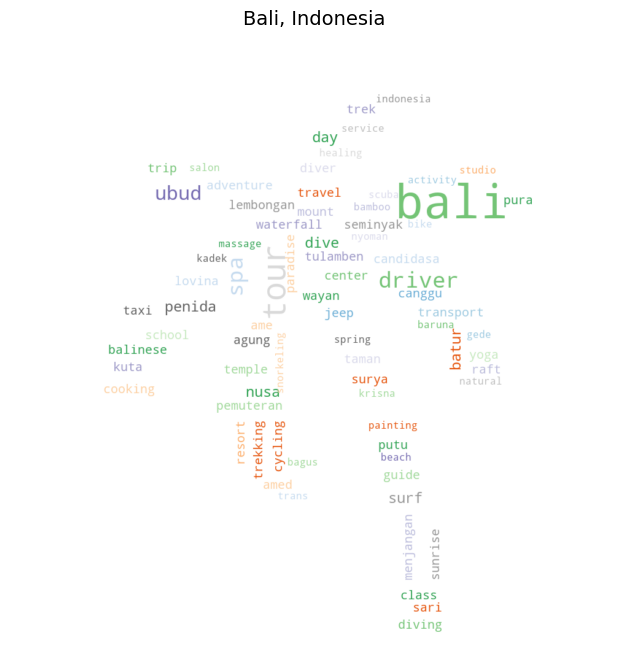

In [50]:
mask = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/palma.png'))
generate_better_wordcloud(dtm_tfidf['Bali, Indonesia'].sort_values(ascending=False),
                          'Bali, Indonesia', mask=mask)

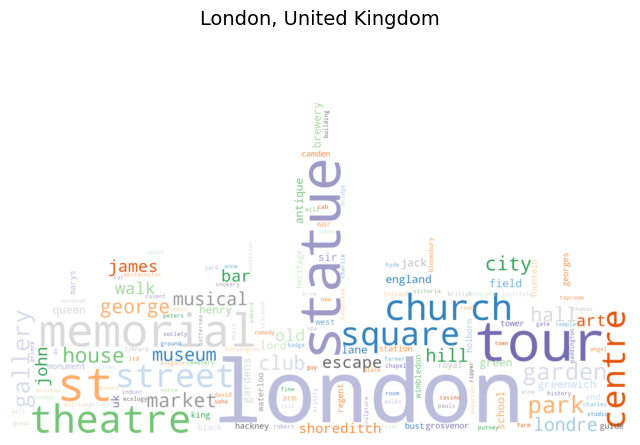

In [51]:
mask_london = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/ben.png'))
generate_better_wordcloud(dtm_tfidf['London, United Kingdom'].sort_values(ascending=False),
                          'London, United Kingdom', mask=mask_london)

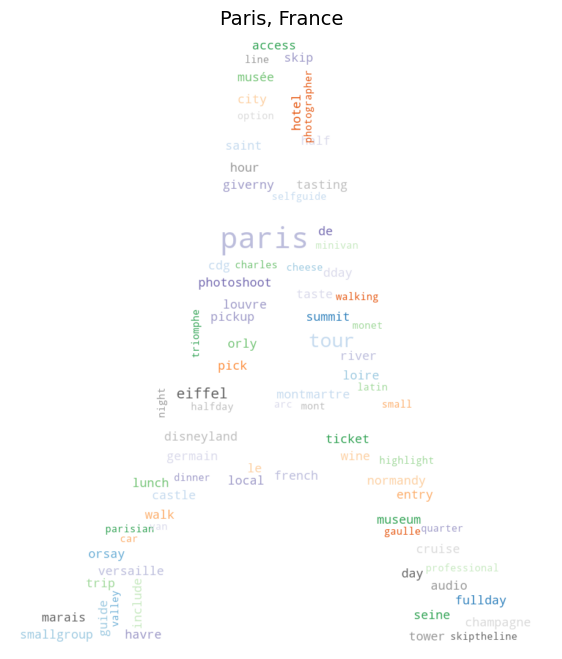

In [52]:
mask_paris = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/eiffel.png'))
generate_better_wordcloud(dtm_tfidf['Paris, France'].sort_values(ascending=False),
                          'Paris, France', mask=mask_paris)

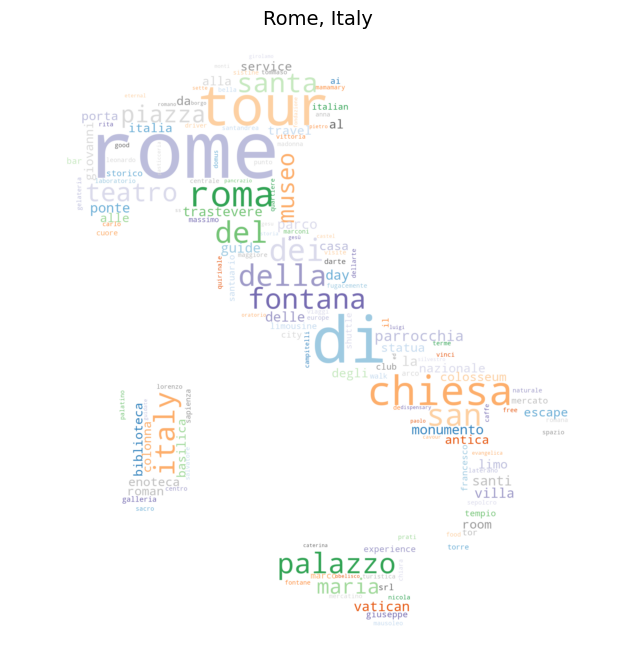

In [53]:
mask_rome = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/italy.png'))
generate_better_wordcloud(dtm_tfidf['Rome, Italy'].sort_values(ascending=False),
                          'Rome, Italy', mask=mask_rome)

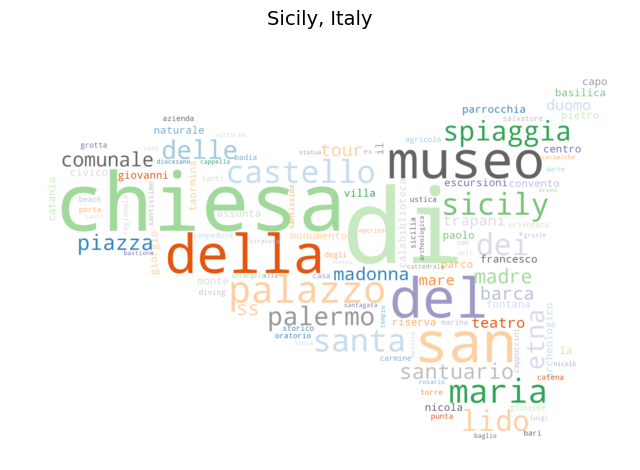

In [54]:
mask_sicily = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/sicily.png'))
generate_better_wordcloud(dtm_tfidf['Sicily, Italy'].sort_values(ascending=False),
                          'Sicily, Italy', mask=mask_sicily)

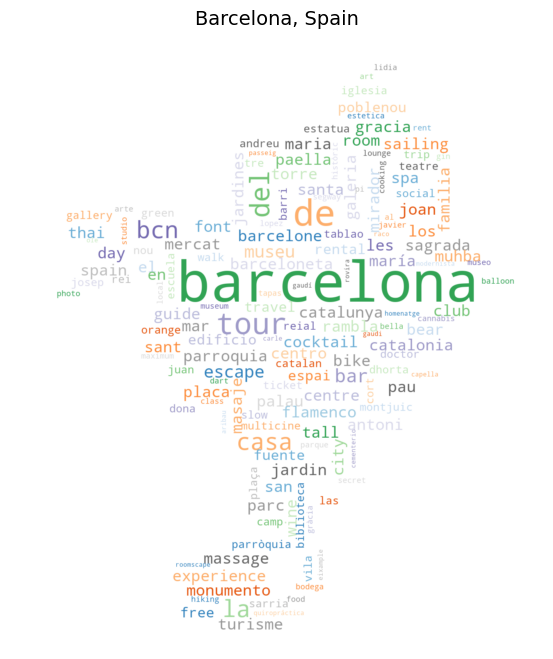

In [55]:
mask_barca = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/barcelona.png'))
generate_better_wordcloud(dtm_tfidf['Barcelona, Spain'].sort_values(ascending=False),
                          'Barcelona, Spain', mask=mask_barca)

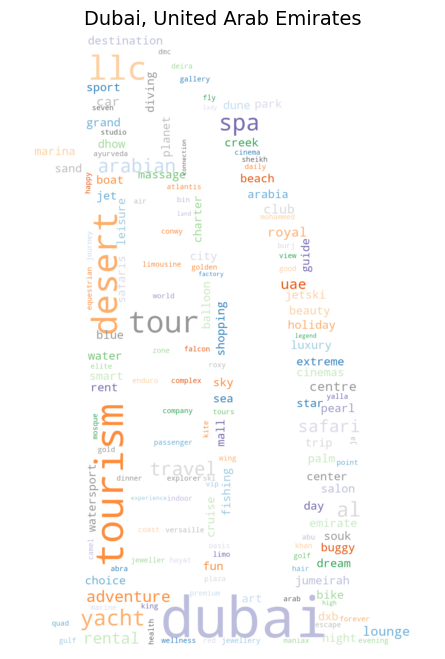

In [56]:
mask_dubai = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/dubai.png'))
generate_better_wordcloud(dtm_tfidf['Dubai, United Arab Emirates'].sort_values(ascending=False),
                          'Dubai, United Arab Emirates', mask=mask_dubai)

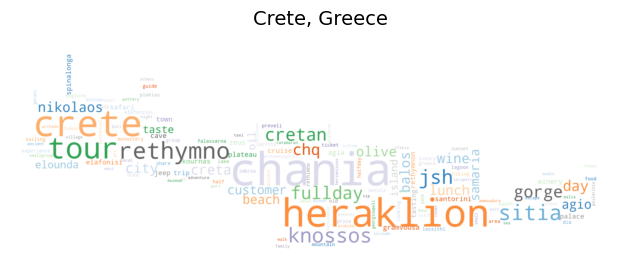

In [57]:
mask_crete = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/crete.png'))
generate_better_wordcloud(dtm_tfidf['Crete, Greece'].sort_values(ascending=False),
                          'Crete, Greece', mask=mask_crete)

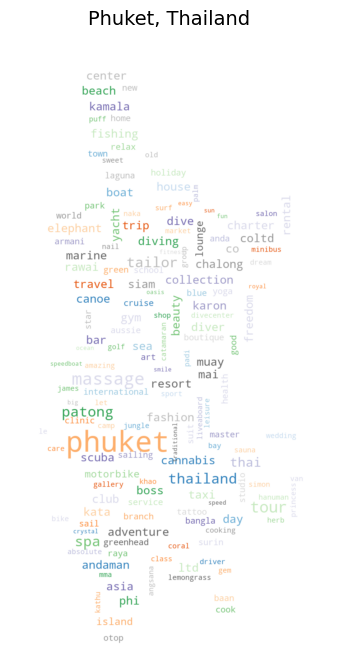

In [58]:
mask_phuket = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/phuket.png'))
generate_better_wordcloud(dtm_tfidf['Phuket, Thailand'].sort_values(ascending=False),
                          'Phuket, Thailand', mask=mask_phuket)

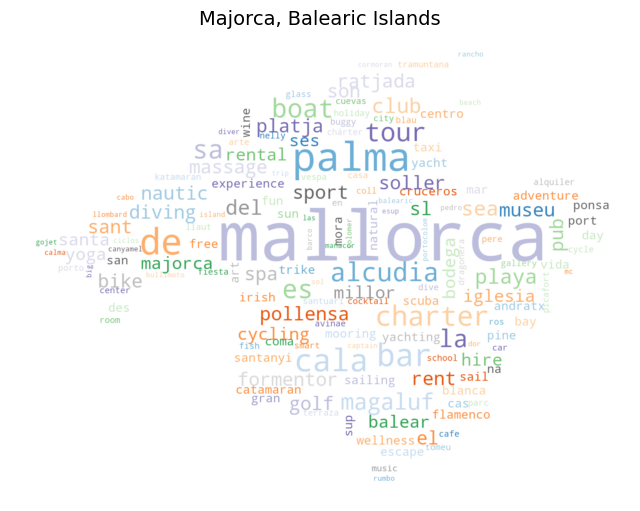

In [59]:
mask_majorca = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/majorca.png'))
generate_better_wordcloud(dtm_tfidf['Majorca, Balearic Islands'].sort_values(ascending=False),
                          'Majorca, Balearic Islands', mask=mask_majorca)

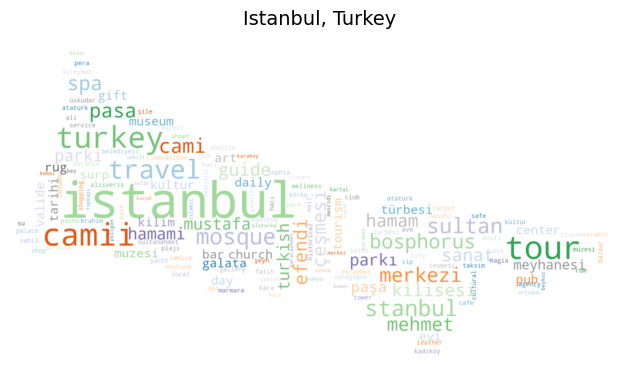

In [60]:
mask_istanbul = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/istanbul.png'))
generate_better_wordcloud(dtm_tfidf['Istanbul, Turkey'].sort_values(ascending=False),
                          'Istanbul, Turkey', mask=mask_istanbul)

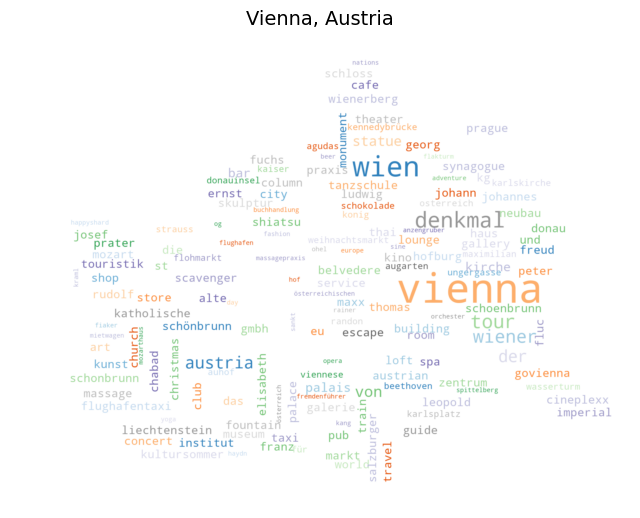

In [61]:
mask_vienna = np.array(Image.open('/Users/lianaavagyan/Desktop/capstone/vienna.png'))
generate_better_wordcloud(dtm_tfidf['Vienna, Austria'].sort_values(ascending=False),
                          'Vienna, Austria', mask=mask_vienna)

### Most Frequent Words Visualizations

####  Finding the most frequent words per city and visualizing them

In [62]:
# Group the corpora by city and join them
df_to_be_group = preprocessed_df[['City', 'lemmatized']]
df_grouped = df_to_be_group.groupby(by='City').agg(lambda x:' '.join(x))
df_grouped

,lemmatized
City,
"Bali, Indonesia",waterbom bali sacred monkey forest sanctuary t...
"Barcelona, Spain",basílica de la sagrada familia casa batlló got...
"Crete, Greece",fullday private adventure knossos zeus cave ...
"Dubai, United Arab Emirates",dubai fountain burj khalifa atlantis aquaventu...
"Istanbul, Turkey",hagia sophia mosque basilica cistern blue mosq...
"London, United Kingdom",royal opera house hms belfast london undergrou...
"Majorca, Balearic Islands",playa cala gran playa de ses saline formentor ...
"Paris, France",paris ultimate food tour musée d’orsay orsay m...
"Phuket, Thailand",big buddha phuket bangla road green elephant s...


In [63]:
bali_text = df_grouped.loc['Bali, Indonesia', 'lemmatized']
fd = FreqDist(word_tokenize(bali_text))
fd.most_common(25)

[('bali', 721),
 ('tour', 429),
 ('spa', 152),
 ('driver', 109),
 ('day', 78),
 ('ubud', 51),
 ('surf', 51),
 ('dive', 47),
 ('adventure', 46),
 ('private', 43),
 ('guide', 32),
 ('class', 28),
 ('transport', 28),
 ('diving', 27),
 ('school', 27),
 ('penida', 27),
 ('travel', 26),
 ('nusa', 24),
 ('trip', 23),
 ('center', 21),
 ('diver', 21),
 ('batur', 21),
 ('pura', 21),
 ('sunrise', 20),
 ('cooking', 18)]

In [64]:
city_frequency = {}
for city in df_grouped.index:
    city_text = df_grouped.loc[city, 'lemmatized']
    
    fd = FreqDist(word_tokenize(city_text))
    city_frequency[city] = fd.most_common(20)
    
city_freqs_df = pd.DataFrame(city_frequency)
city_freqs_df.head(10)

,"Bali, Indonesia","Barcelona, Spain","Crete, Greece","Dubai, United Arab Emirates","Istanbul, Turkey","London, United Kingdom","Majorca, Balearic Islands","Paris, France","Phuket, Thailand","Rome, Italy","Sicily, Italy","Vienna, Austria"
0,"(bali, 721)","(barcelona, 300)","(private, 382)","(dubai, 310)","(istanbul, 192)","(london, 215)","(mallorca, 198)","(paris, 1082)","(phuket, 371)","(tour, 248)","(di, 426)","(vienna, 157)"
1,"(tour, 429)","(de, 202)","(tour, 349)","(tourism, 208)","(tour, 174)","(tour, 140)","(de, 77)","(tour, 833)","(tour, 141)","(di, 212)","(chiesa, 221)","(tour, 62)"
2,"(spa, 152)","(tour, 144)","(transfer, 212)","(tour, 192)","(travel, 109)","(statue, 83)","(bar, 56)","(private, 706)","(massage, 135)","(rome, 199)","(san, 130)","(wien, 50)"
3,"(driver, 109)","(la, 70)","(chania, 208)","(spa, 94)","(camii, 56)","(st, 74)","(tour, 39)","(guide, 227)","(spa, 88)","(chiesa, 92)","(del, 114)","(denkmal, 27)"
4,"(day, 78)","(del, 57)","(heraklion, 207)","(desert, 91)","(spa, 54)","(memorial, 54)","(charter, 36)","(transfer, 175)","(travel, 59)","(san, 70)","(museo, 102)","(bar, 24)"
5,"(ubud, 51)","(casa, 51)","(crete, 190)","(llc, 81)","(turkey, 53)","(park, 49)","(boat, 35)","(day, 164)","(tailor, 57)","(roma, 70)","(della, 84)","(wiener, 22)"
6,"(surf, 51)","(bar, 46)","(airport, 187)","(travel, 78)","(transfer, 50)","(church, 48)","(palma, 34)","(eiffel, 150)","(bar, 56)","(dei, 56)","(palazzo, 76)","(statue, 19)"
7,"(dive, 47)","(escape, 35)","(day, 95)","(adventure, 63)","(guide, 44)","(gallery, 44)","(la, 30)","(cruise, 137)","(thai, 52)","(del, 56)","(maria, 74)","(transfer, 19)"
8,"(adventure, 46)","(bcn, 32)","(rethymno, 89)","(al, 60)","(mosque, 33)","(theatre, 43)","(cala, 25)","(airport, 128)","(day, 38)","(santa, 46)","(santa, 66)","(museum, 18)"
9,"(private, 43)","(room, 27)","(city, 74)","(yacht, 54)","(airport, 33)","(street, 39)","(club, 22)","(tower, 114)","(fashion, 36)","(palazzo, 44)","(dei, 49)","(airport, 18)"


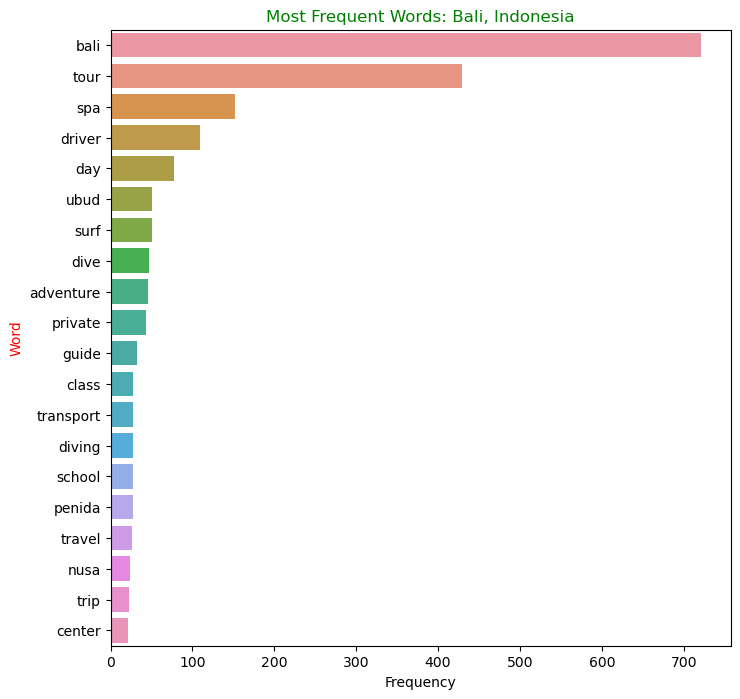

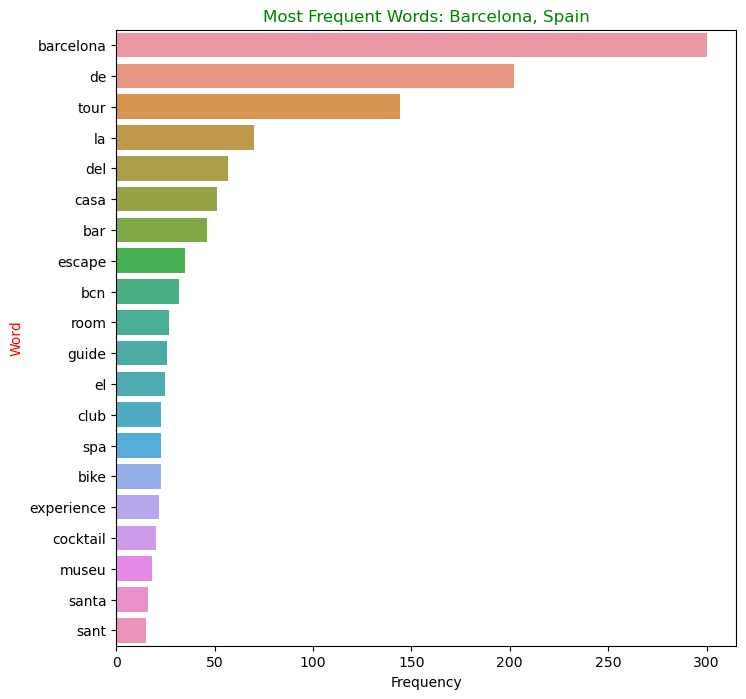

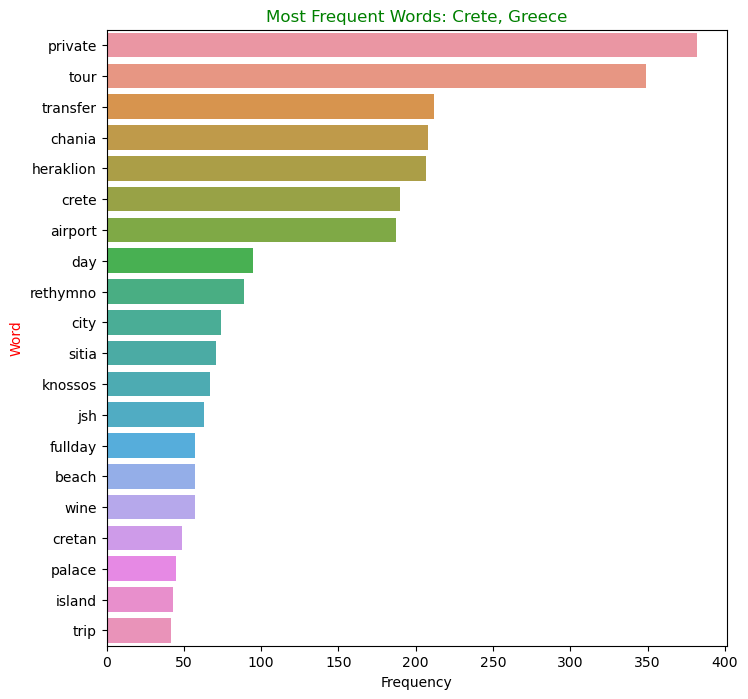

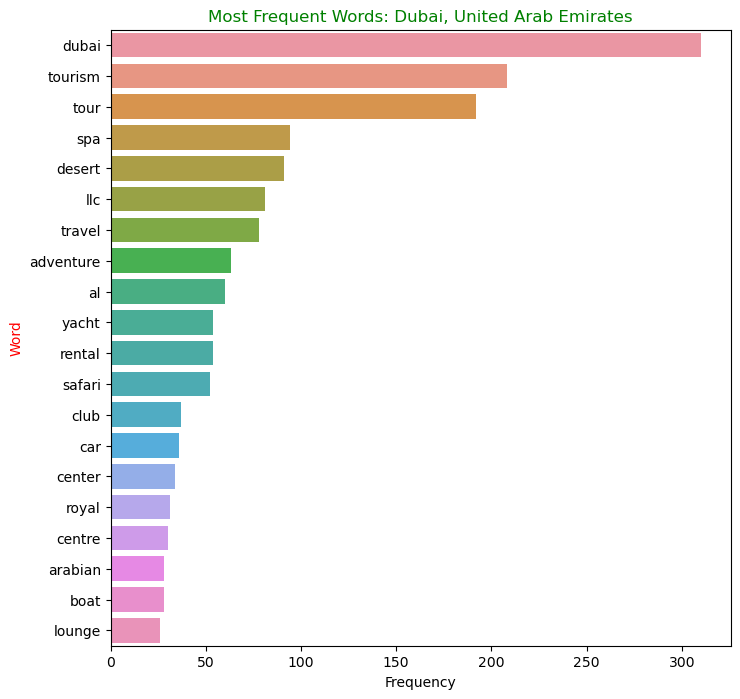

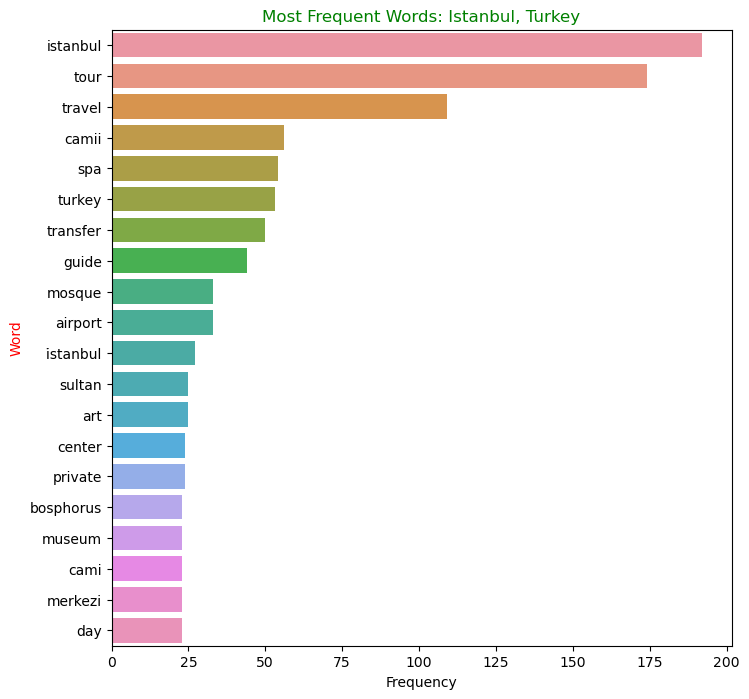

...

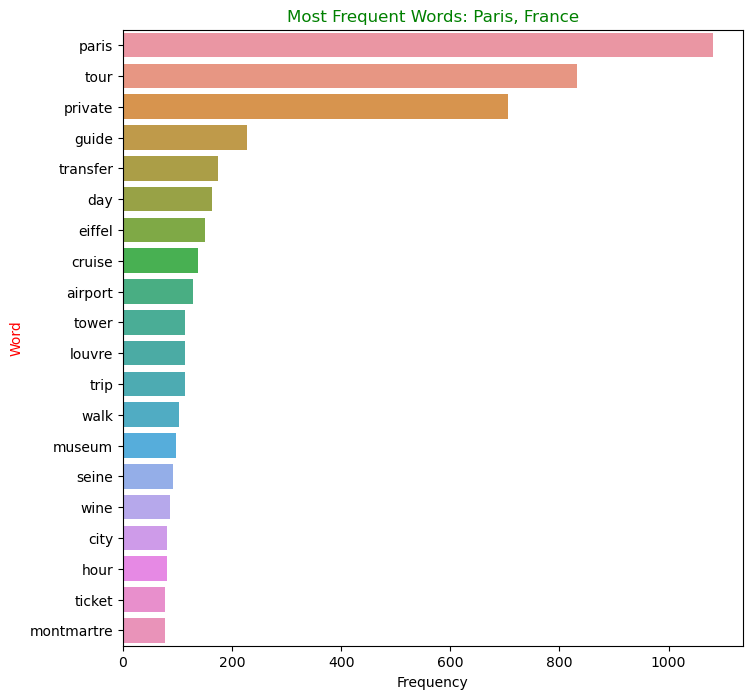

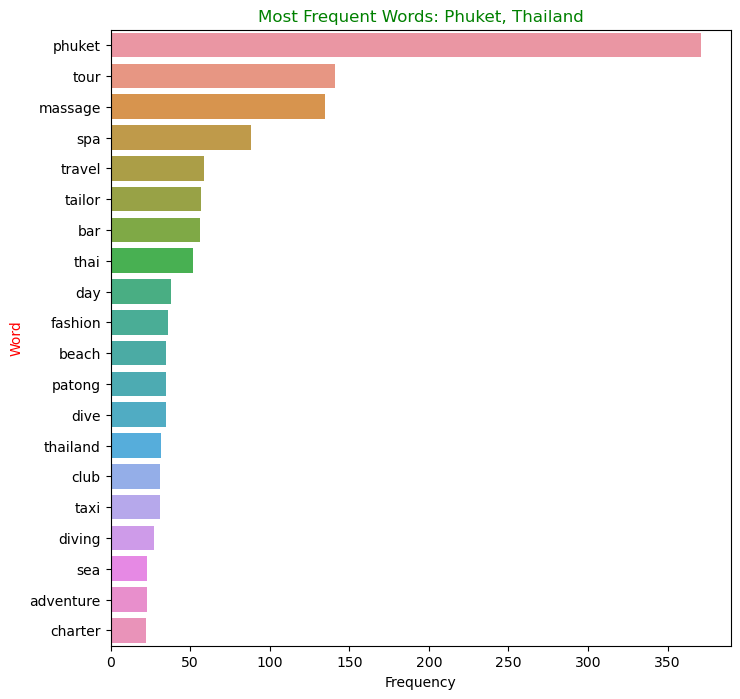

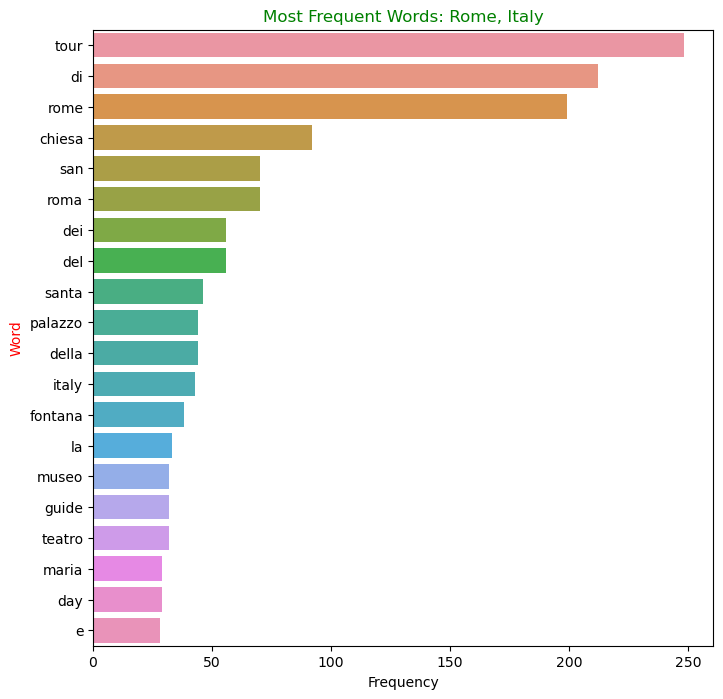

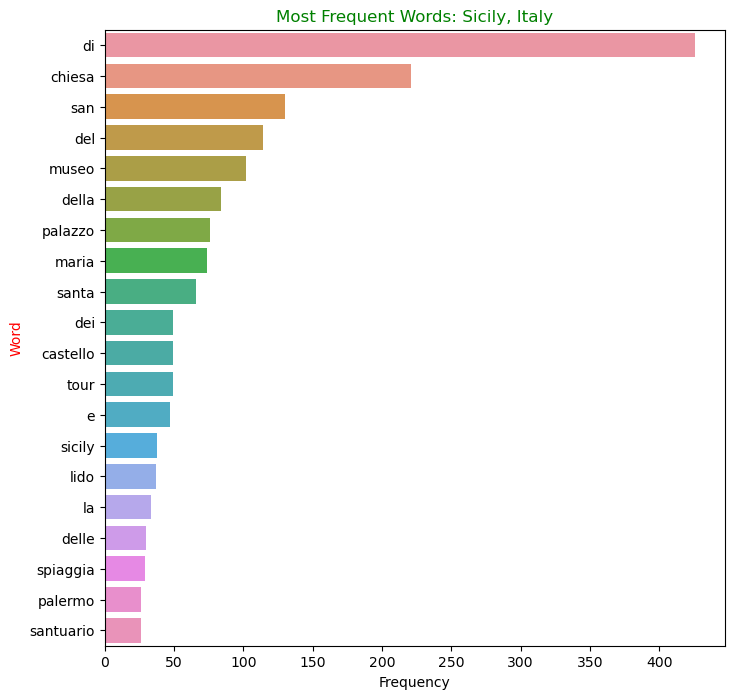

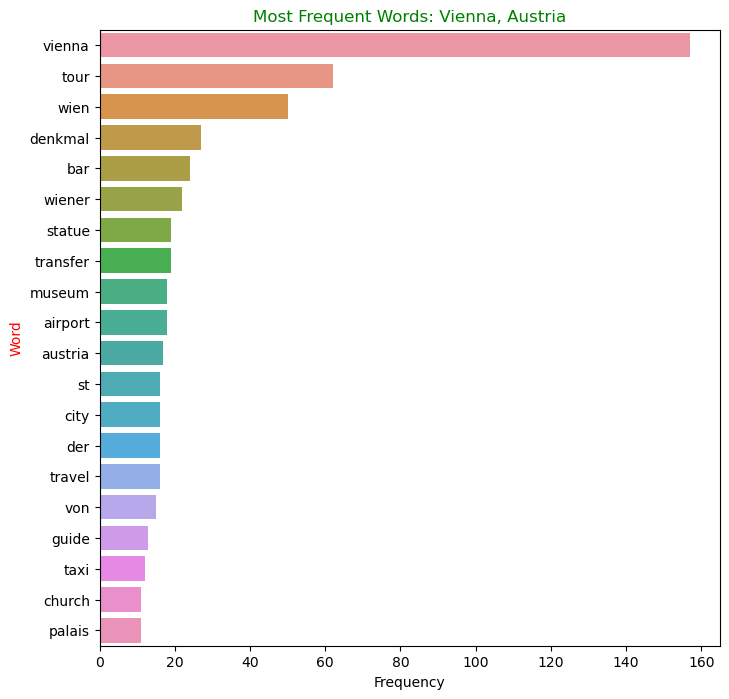

In [65]:
# Making graphs for the most frequent words per each city

for city in city_freqs_df.columns:    
    yaxis = [x[0] for x in city_freqs_df[city]]
    xaxis = [x[1] for x in city_freqs_df[city]]

    plt.figure(figsize=(8,8))
    sns.barplot(x=xaxis, y=yaxis)
    plt.title(f'Most Frequent Words: {city}', color='green')
    plt.xlabel('Frequency')
    plt.ylabel('Word', color='red')
    plt.show()

# Modeling

### Baseline Naive Bayes Model

In [66]:
# Now re-importing the data to get a fresh start

data = pd.read_csv('/Users/lianaavagyan/Desktop/capstone/cities_df', index_col=0)
data.head(10)

,Attraction,City
0,Royal Opera House,"London, United Kingdom"
1,HMS Belfast,"London, United Kingdom"
2,London Underground,"London, United Kingdom"
3,Tottenham Hotspur Stadium Tour,"London, United Kingdom"
4,Frameless,"London, United Kingdom"
5,Museum of Brands,"London, United Kingdom"
6,Greenwich Park,"London, United Kingdom"
7,Westminster,"London, United Kingdom"
8,National Maritime Museum,"London, United Kingdom"
9,Emirates Stadium Tour and Museum,"London, United Kingdom"


In [67]:
# Performing the train/test split before cleaning/preprocessing

X = data['Attraction']
y = data['City']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=555, stratify=y)
X_train.shape, X_test.shape

((14134,), (3534,))

In [68]:
# Since this is a series, making it a DF for the preprocessing function is done

X_train

308      The Best of Paris Food Tour, EXPLORE FOOD TOURS.
331                                    Vienna Airport Cab
1372                                    Olgiata Golf Club
1261                                  Beauty Nail Concept
1162                                       Galeri Kayseri
                              ...                        
356     5-Hour Snorkeling Experience in Kourtaliotiko ...
1541                                            Muse Artz
1469                                       Talixo - Dubai
1105                                  METAMarkt Flohmarkt
1454                                     The Cut Bcn Club
Name: Attraction, Length: 14134, dtype: object

In [69]:
X_train_preprocessed = preprocess_df(pd.DataFrame(X_train, columns=['Attraction']), 'lemmatized')

X_test_preprocessed = preprocess_df(pd.DataFrame(X_test, columns=['Attraction']), 'lemmatized')

,Attraction,lemmatized
308,"The Best of Paris Food Tour, EXPLORE FOOD TOURS.",good paris food tour explore food tour
331,Vienna Airport Cab,vienna airport cab
1372,Olgiata Golf Club,olgiata golf club
1261,Beauty Nail Concept,beauty nail concept
1162,Galeri Kayseri,galeri kayseri
1060,E-Bike City Tour in Paris,ebike city tour paris
1559,Koala 2.0 Industry Aps,koala industry aps
996,Mushrif Cliff,mushrif cliff
514,Mallorca Top Charters,mallorca charter
1169,Teatro Selinus,teatro selinus


,Attraction,lemmatized
1574,Istanbul Jewish Tours - Day Tours,istanbul jewish tour day tour
618,Saba Bali Trans - Day Tours,saba bali trans day tour
402,Romantic Sailing,romantic sailing
152,Twilight Sea Canoe Phuket,twilight sea canoe phuket
17,Monastero dei Benedettini,monastero dei benedettini
183,Etna 'Ngeniousa,etna ngeniousa
1412,Paris: Private Pastry Food Tour of French Swee...,paris private pastry food tour french sweet de...
229,GoCar GPS Guided Tours,gocar gps guide tour
1037,Magda Danysz Gallery,magda danysz gallery
17,Private Rethymno Oil and Honey Tasting Pottery...,private rethymno oil honey taste pottery marga...


In [70]:
stopwords_list = stopwords.words('english')
stopwords_list += list(string.punctuation)
stopwords_list += ['airport', 'transfer', 'private']
stopwords_list += ['bali', 'barcelona', 'crete', 'dubai','istanbul', 'london', 'majorca', 'phuket',
                                  'paris', 'rome', 'sicily', 'mallorca', 'vienna']

In [71]:
# Vectorize the text data to be suitable for modeling

vectorizer = TfidfVectorizer(analyzer='word', stop_words=stopwords_list, decode_error='ignore')
X_train_tfidf = vectorizer.fit_transform(X_train_preprocessed['lemmatized'])
X_test_tfidf = vectorizer.transform(X_test_preprocessed['lemmatized'])

In [72]:
def conf_matrix(y_true, y_pred):
    
    cm = confusion_matrix(y_true, y_pred, normalize='true')
    plt.figure(figsize=(12, 12))
    sns.heatmap(cm, annot=True, cmap='Blues', fmt='0.2g', annot_kws={"size": 10},
                xticklabels=nb.classes_, yticklabels=nb.classes_, square=True)
    
    plt.xlabel('Predictions', color='green')
    plt.ylabel('Actual Values', color='red')
    plt.show()

In [73]:
def evaluate_model(model, X_train, X_test):
    y_preds_train = model.predict(X_train)
    y_preds_test = model.predict(X_test)

    print('Training Accuracy:', accuracy_score(y_train, y_preds_train))
    print('Testing Accuracy:', accuracy_score(y_test, y_preds_test))
    print('\n---------------\n')
    print('Training F1:', f1_score(y_train, y_preds_train, average='weighted'))
    print('Testing F1:', f1_score(y_test, y_preds_test, average='weighted'))
    print('\n---------------\n')
    print('Train Confusion Matrix\n')
    conf_matrix(y_train, y_preds_train)
    print('Test Confusion Matrix\n')
    conf_matrix(y_test, y_preds_test)
    print('\n----------------\n')
    print(classification_report(y_test, y_preds_test))

    print('Accuracy score:', accuracy_score(y_test, y_preds_test))

In [74]:
# Training the classifier

nb = MultinomialNB()
nb.fit(X_train_tfidf, y_train)

MultinomialNB()

In [75]:
nb.classes_

array(['Bali, Indonesia', 'Barcelona, Spain', 'Crete, Greece',
       'Dubai, United Arab Emirates', 'Istanbul, Turkey',
       'London, United Kingdom', 'Majorca, Balearic Islands',
       'Paris, France', 'Phuket, Thailand', 'Rome, Italy',
       'Sicily, Italy', 'Vienna, Austria'], dtype='<U27')

Training Accuracy: 0.816470921182963
Testing Accuracy: 0.5933786078098472

---------------

Training F1: 0.8156054410285591
Testing F1: 0.5850171242166063

---------------

Train Confusion Matrix



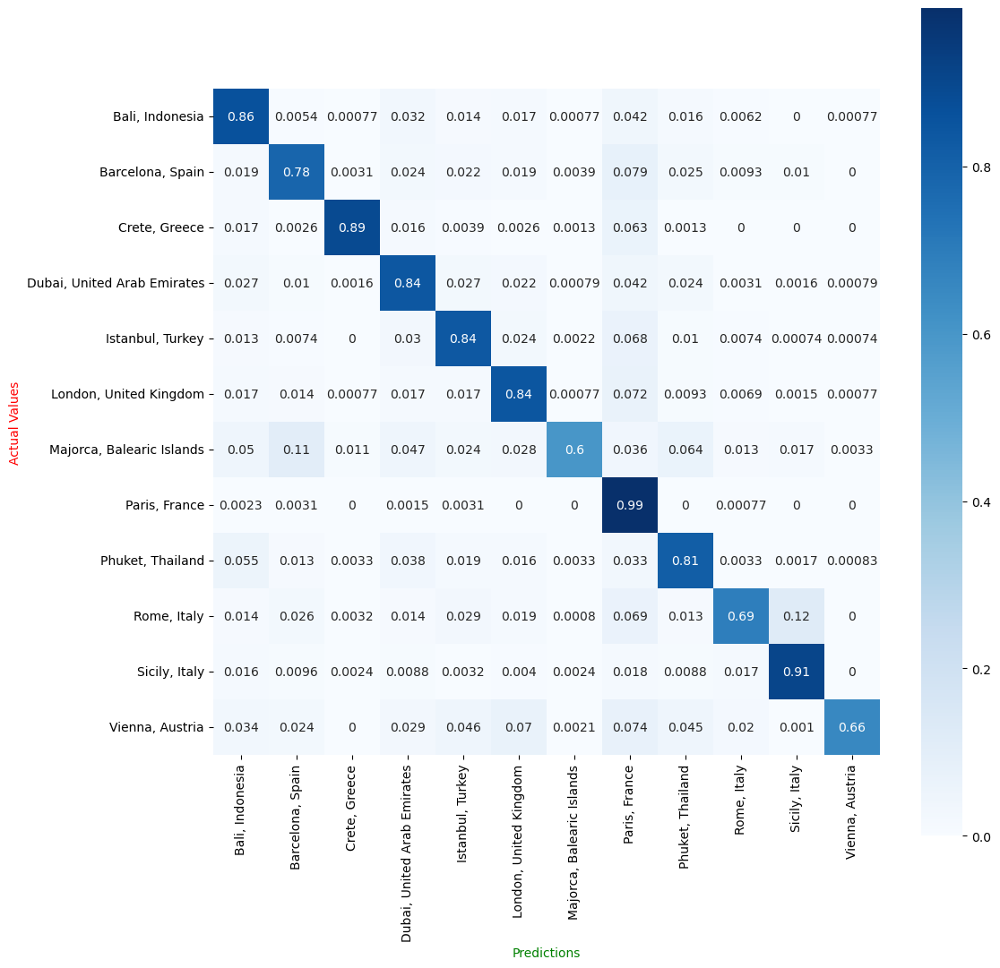

Test Confusion Matrix



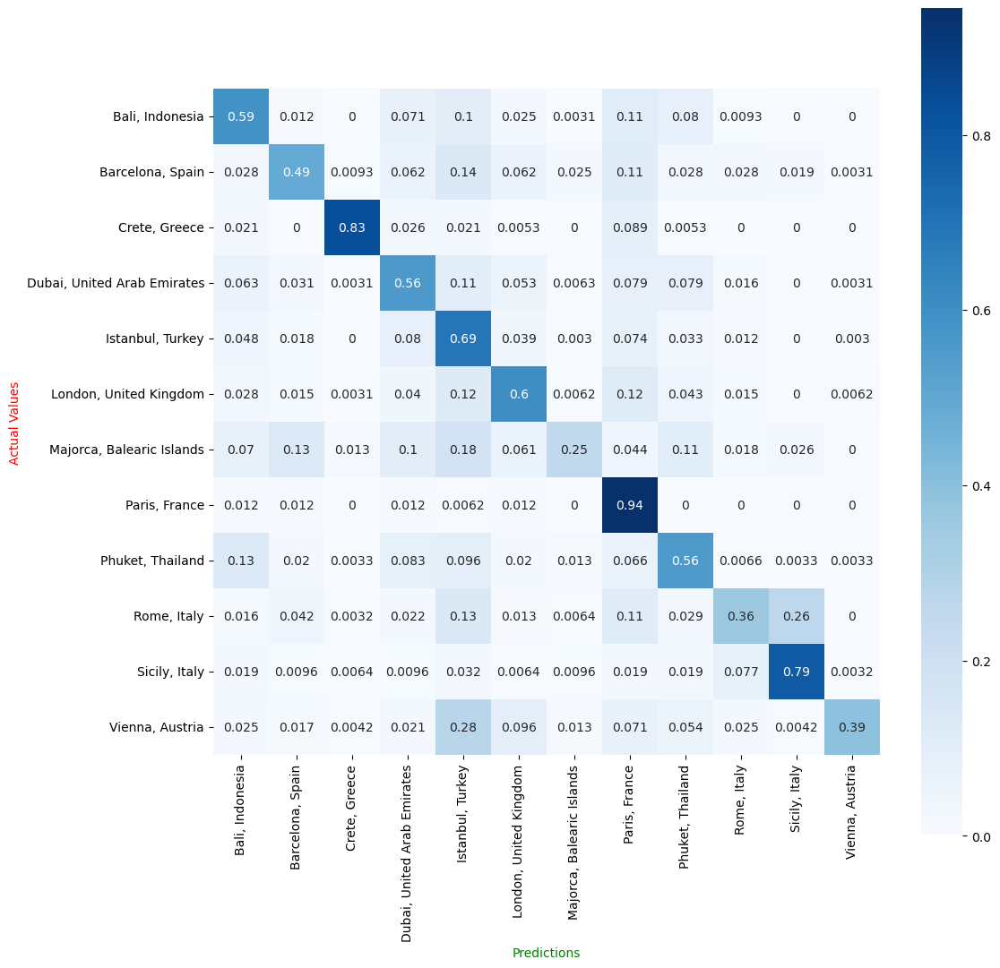


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.59      0.59      0.59       324
           Barcelona, Spain       0.65      0.49      0.56       324
              Crete, Greece       0.92      0.83      0.88       190
Dubai, United Arab Emirates       0.53      0.56      0.55       318
           Istanbul, Turkey       0.40      0.69      0.51       336
     London, United Kingdom       0.64      0.60      0.62       324
  Majorca, Balearic Islands       0.69      0.25      0.37       228
              Paris, France       0.54      0.94      0.68       324
           Phuket, Thailand       0.55      0.56      0.55       302
                Rome, Italy       0.64      0.36      0.46       312
              Sicily, Italy       0.72      0.79      0.75       312
            Vienna, Austria       0.93      0.39      0.55       240

                   accuracy                           0.59      3534
             

In [76]:
evaluate_model(nb, X_train_tfidf, X_test_tfidf)

#### This model performs well. 
#### However, the 3 classes with the lowest accuracy and F1 scores are Majorca, Rome and Vienna. 

#### Now we need to ensure that the class imbalance is not affecting this model. 
#### We will fix this issue using class weights in the next iteration.

### Naive Bayes Iteration 2

#### Using class weights to improve class imbalance.

In [77]:
# Compute class weights
class_weights = class_weight.compute_class_weight('balanced', classes = np.unique(y_train),y = y_train)
weights_dict = dict(zip(np.unique(y_train), class_weights))

In [78]:
weights_dict

{'Bali, Indonesia': 0.9088220164609053,
 'Barcelona, Spain': 0.9088220164609053,
 'Crete, Greece': 1.5497807017543859,
 'Dubai, United Arab Emirates': 0.9259696016771488,
 'Istanbul, Turkey': 0.8763640873015873,
 'London, United Kingdom': 0.9088220164609053,
 'Majorca, Balearic Islands': 1.2957462412907959,
 'Paris, France': 0.9088220164609053,
 'Phuket, Thailand': 0.9742211193824097,
 'Rome, Italy': 0.9437767094017094,
 'Sicily, Italy': 0.9437767094017094,
 'Vienna, Austria': 1.2269097222222223}

In [79]:
# Using the class weights dictionary to calculate sample weight (needed for MultinomialNB)

sample_weights = class_weight.compute_sample_weight(weights_dict, y_train)

In [80]:
nb = MultinomialNB()
nb.fit(X_train_tfidf,y_train, sample_weight=sample_weights)

MultinomialNB()

Training Accuracy: 0.8267298712324891
Testing Accuracy: 0.5942275042444821

---------------

Training F1: 0.8264869894953333
Testing F1: 0.5921753392386827

---------------

Train Confusion Matrix



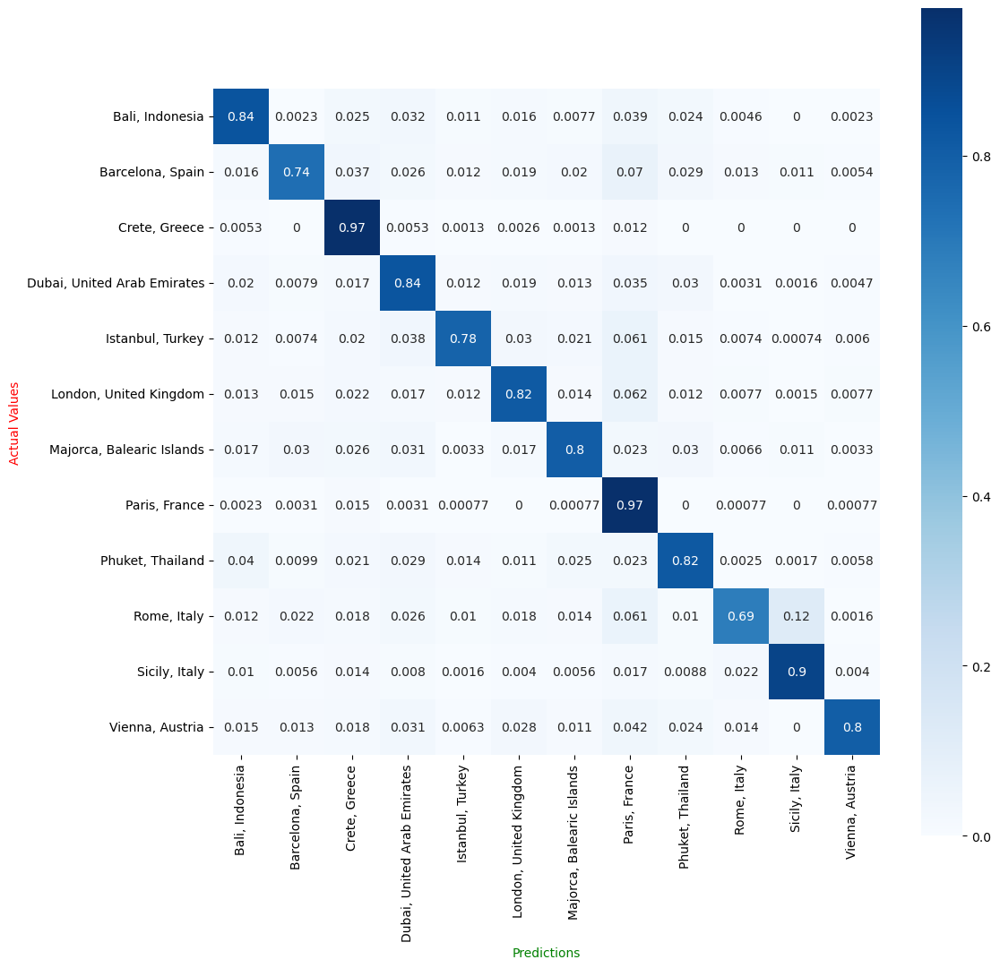

Test Confusion Matrix



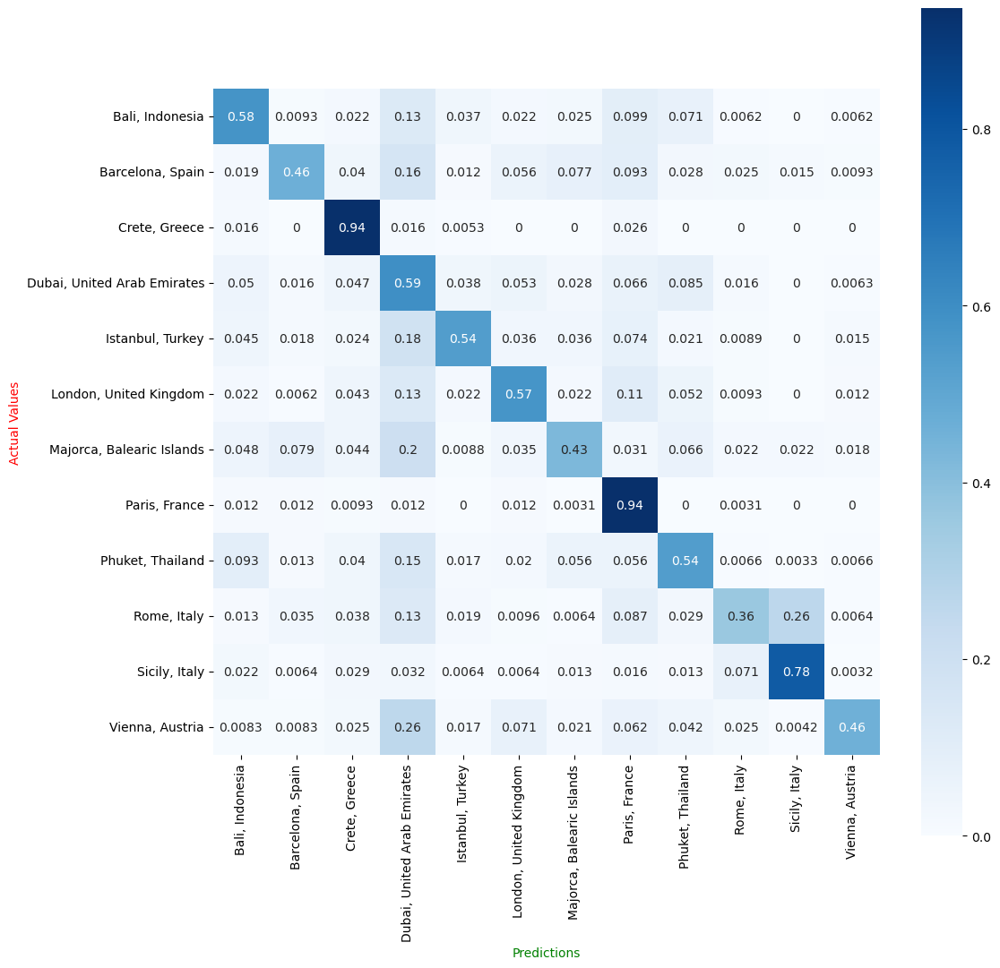


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.64      0.58      0.61       324
           Barcelona, Spain       0.72      0.46      0.56       324
              Crete, Greece       0.62      0.94      0.75       190
Dubai, United Arab Emirates       0.32      0.59      0.41       318
           Istanbul, Turkey       0.77      0.54      0.63       336
     London, United Kingdom       0.66      0.57      0.61       324
  Majorca, Balearic Islands       0.52      0.43      0.47       228
              Paris, France       0.58      0.94      0.72       324
           Phuket, Thailand       0.57      0.54      0.56       302
                Rome, Italy       0.66      0.36      0.47       312
              Sicily, Italy       0.72      0.78      0.75       312
            Vienna, Austria       0.81      0.46      0.59       240

                   accuracy                           0.59      3534
             

In [81]:
evaluate_model(nb, X_train_tfidf, X_test_tfidf)

#### This model performs better. 
#### But in many of these cities' attractions text, the name of the city is included. This may become an issue in the future because when we introduce new text to this model, it may not include the city name.

### Naive Bayes Iteration 3

#### Seeing what happens if city names are taken out.

In [82]:
new_stopwords = stopwords_list

In [83]:
vectorizer = TfidfVectorizer(analyzer='word',
                             stop_words=new_stopwords,
                             decode_error='ignore')

X_train_tfidf = vectorizer.fit_transform(X_train_preprocessed['lemmatized'])
X_test_tfidf = vectorizer.transform(X_test_preprocessed['lemmatized'])

In [84]:
nb = MultinomialNB()
nb.fit(X_train_tfidf,
       y_train,
       sample_weight=sample_weights)

MultinomialNB()

Training Accuracy: 0.8267298712324891
Testing Accuracy: 0.5942275042444821

---------------

Training F1: 0.8264869894953333
Testing F1: 0.5921753392386827

---------------

Train Confusion Matrix



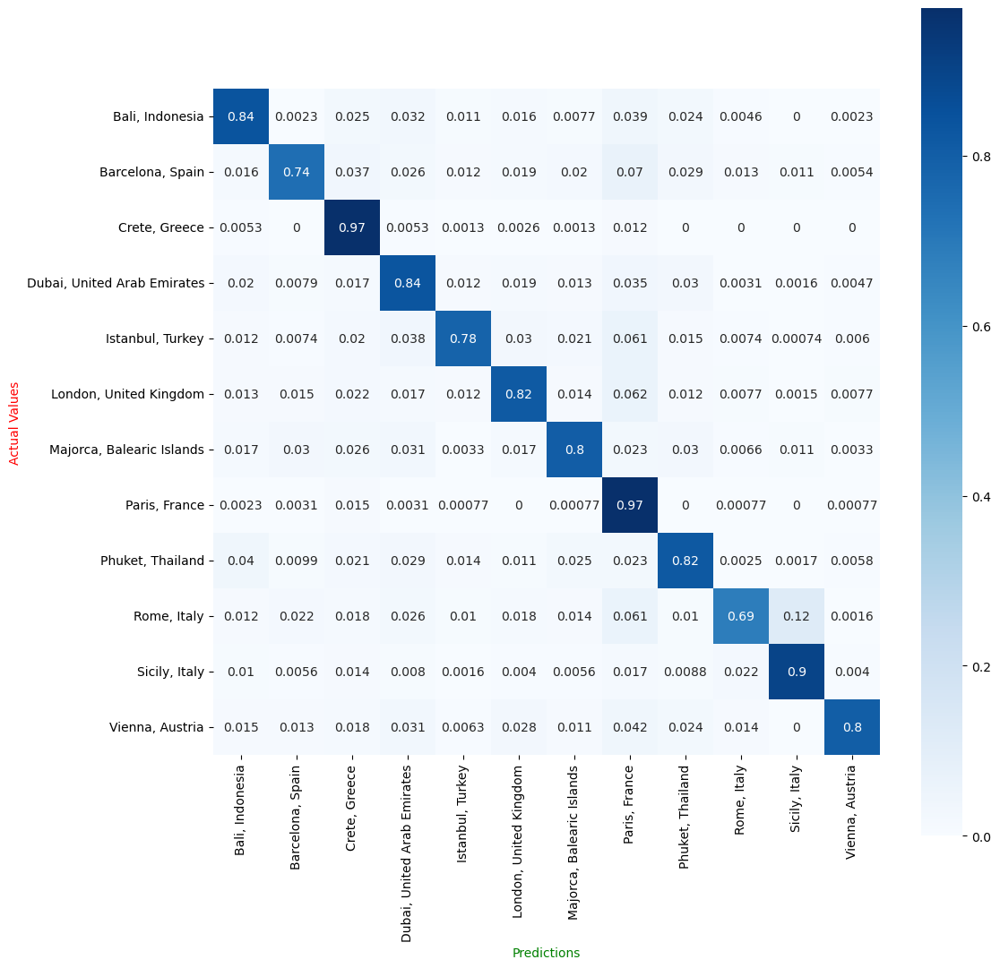

Test Confusion Matrix



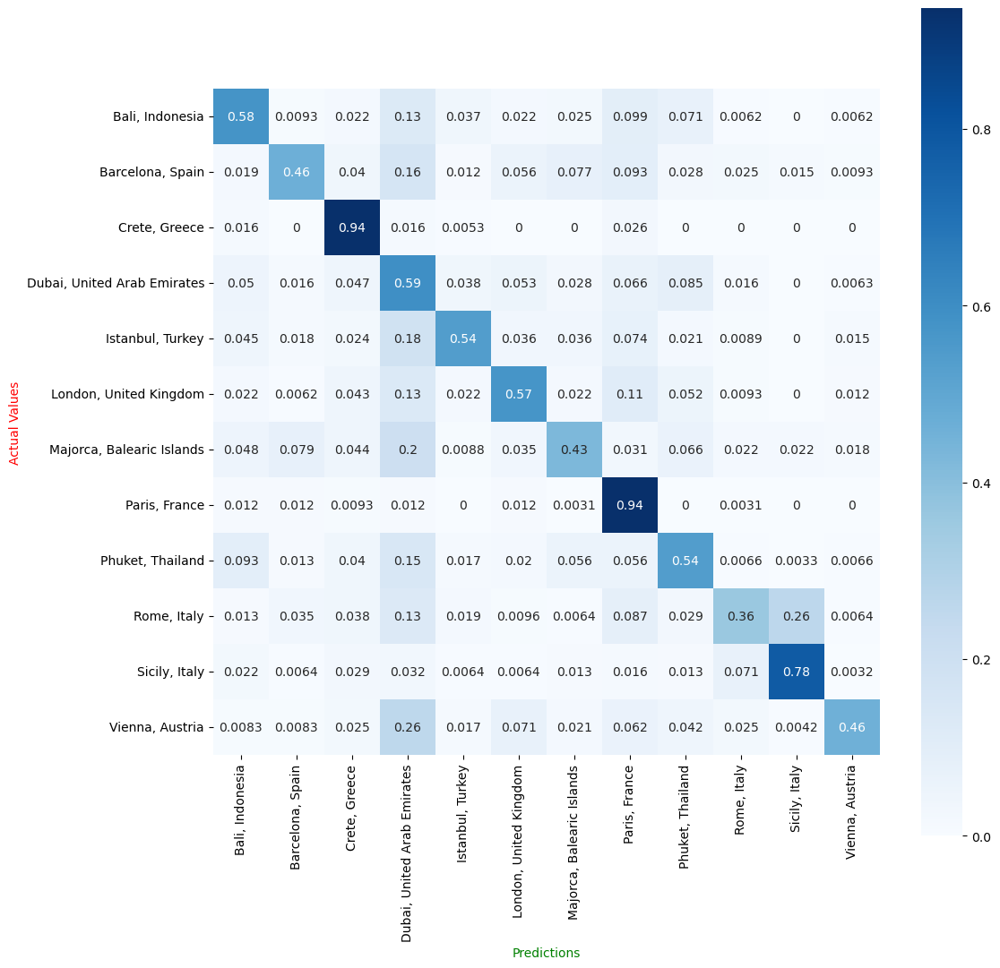


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.64      0.58      0.61       324
           Barcelona, Spain       0.72      0.46      0.56       324
              Crete, Greece       0.62      0.94      0.75       190
Dubai, United Arab Emirates       0.32      0.59      0.41       318
           Istanbul, Turkey       0.77      0.54      0.63       336
     London, United Kingdom       0.66      0.57      0.61       324
  Majorca, Balearic Islands       0.52      0.43      0.47       228
              Paris, France       0.58      0.94      0.72       324
           Phuket, Thailand       0.57      0.54      0.56       302
                Rome, Italy       0.66      0.36      0.47       312
              Sicily, Italy       0.72      0.78      0.75       312
            Vienna, Austria       0.81      0.46      0.59       240

                   accuracy                           0.59      3534
             

In [85]:
evaluate_model(nb, X_train_tfidf, X_test_tfidf)

These are more realistic accuracy scores and F1 scores for when we introduce new text to the model.

In [86]:
# Saving the Naive Bayes Model
joblib.dump(nb, '/Users/lianaavagyan/Desktop/capstone/nb_model')

['/Users/lianaavagyan/Desktop/capstone/nb_model']

## Iteration 4: Using Count Vectorization

Training Accuracy: 0.7868260931088156
Testing Accuracy: 0.5812110922467459

---------------

Training F1: 0.7879208611373711
Testing F1: 0.5778616909373302

---------------

Train Confusion Matrix



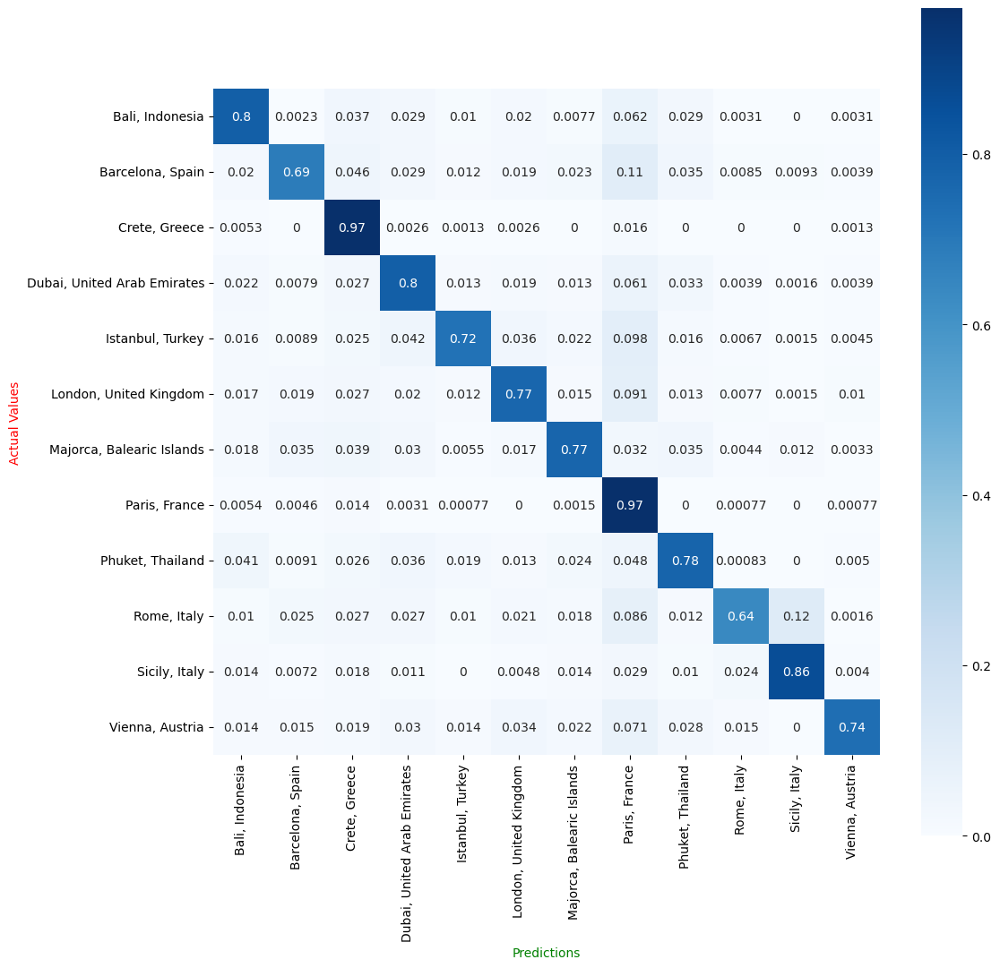

Test Confusion Matrix



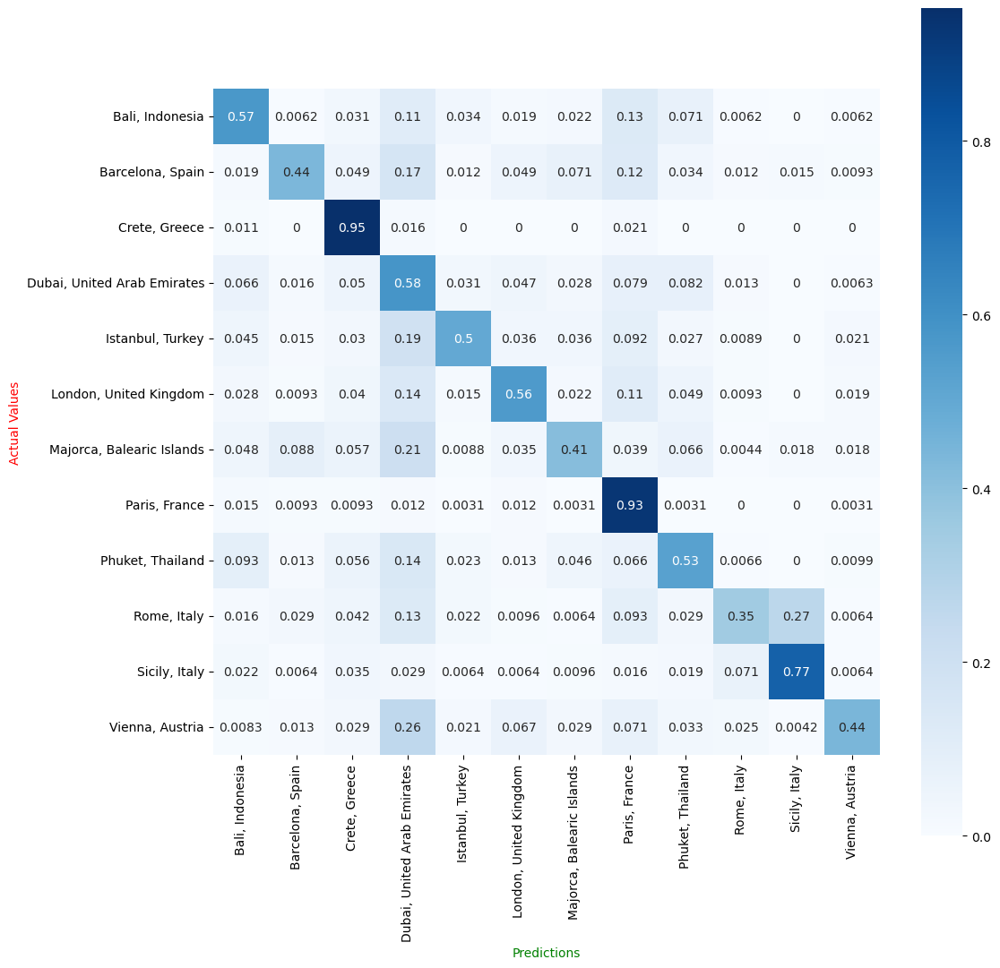


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.62      0.57      0.60       324
           Barcelona, Spain       0.72      0.44      0.54       324
              Crete, Greece       0.58      0.95      0.72       190
Dubai, United Arab Emirates       0.31      0.58      0.41       318
           Istanbul, Turkey       0.76      0.50      0.60       336
     London, United Kingdom       0.68      0.56      0.61       324
  Majorca, Balearic Islands       0.53      0.41      0.46       228
              Paris, France       0.54      0.93      0.68       324
           Phuket, Thailand       0.56      0.53      0.55       302
                Rome, Italy       0.70      0.35      0.47       312
              Sicily, Italy       0.72      0.77      0.74       312
            Vienna, Austria       0.77      0.44      0.56       240

                   accuracy                           0.58      3534
             

In [87]:
# Continuing each new iteration without city names 

cv = CountVectorizer(analyzer='word',
                     stop_words=new_stopwords,
                     decode_error='ignore')
X_train_cv = cv.fit_transform(X_train_preprocessed['lemmatized'])
X_test_cv = cv.transform(X_test_preprocessed['lemmatized'])
nb_cv = MultinomialNB()
nb_cv.fit(X_train_cv,
          y_train,
          sample_weight=sample_weights)

evaluate_model(nb_cv, X_train_cv, X_test_cv)

With count vectorization, the scores are very similar, but still lower than with TF-IDF vectorization, therefore we will keep the TF-IDF vectorization strategy.

### Iteration 5: Using Bi-Grams

Training Accuracy: 0.8490873072024905
Testing Accuracy: 0.3975664968873797

---------------

Training F1: 0.8632809379697657
Testing F1: 0.42902370267053525

---------------

Train Confusion Matrix



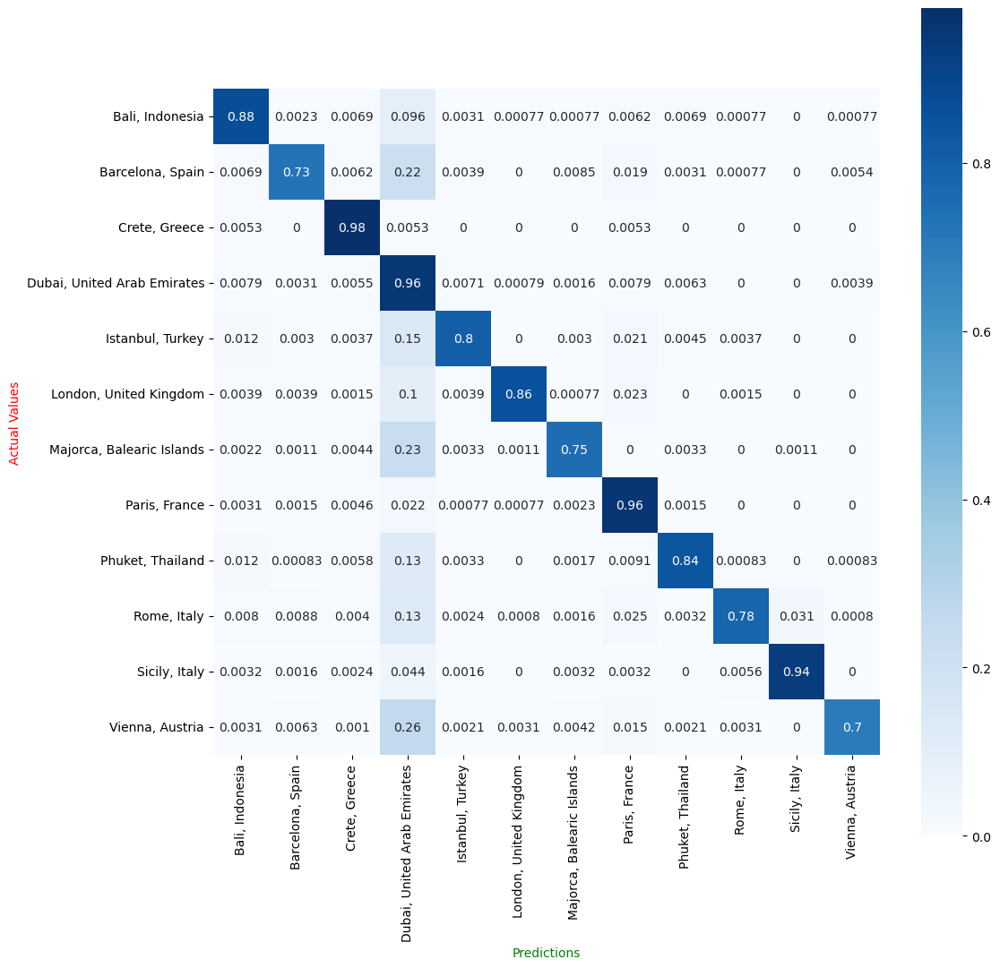

Test Confusion Matrix



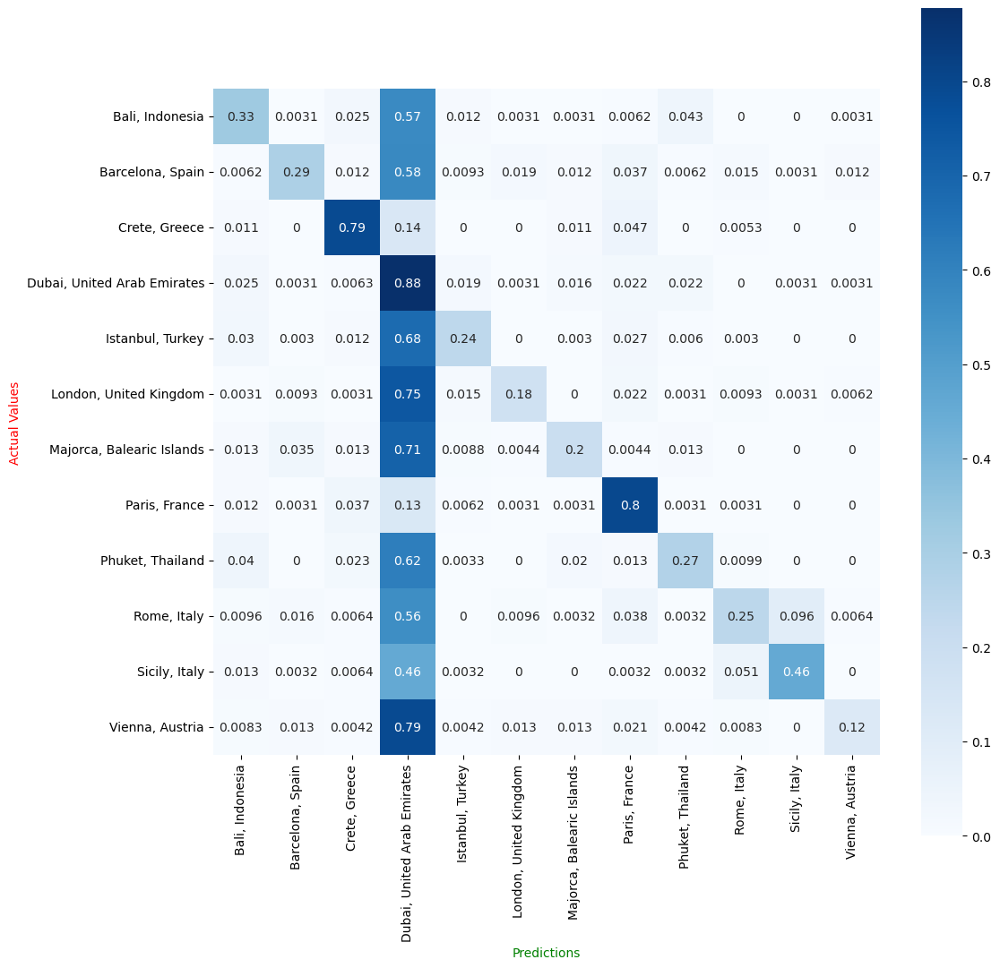


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.68      0.33      0.44       324
           Barcelona, Spain       0.80      0.29      0.43       324
              Crete, Greece       0.77      0.79      0.78       190
Dubai, United Arab Emirates       0.14      0.88      0.24       318
           Istanbul, Turkey       0.76      0.24      0.37       336
     London, United Kingdom       0.78      0.18      0.29       324
  Majorca, Balearic Islands       0.66      0.20      0.31       228
              Paris, France       0.79      0.80      0.79       324
           Phuket, Thailand       0.72      0.27      0.40       302
                Rome, Italy       0.71      0.25      0.37       312
              Sicily, Italy       0.81      0.46      0.59       312
            Vienna, Austria       0.74      0.12      0.21       240

                   accuracy                           0.40      3534
             

In [88]:
bigram = CountVectorizer(analyzer='word',
                         stop_words=new_stopwords,
                         decode_error='ignore',
                         ngram_range=(2,2))
X_train_bg = bigram.fit_transform(X_train_preprocessed['lemmatized'])
X_test_bg = bigram.transform(X_test_preprocessed['lemmatized'])
nb_bg = MultinomialNB()
nb_bg.fit(X_train_bg,y_train, sample_weight=sample_weights)

evaluate_model(nb_bg, X_train_bg, X_test_bg)

The bi-grams did well for the training accuracy, but not that great for the testing accuracy. 

Thus, the TF-IDF vectorization is the best vectorization strategy for this dataset.

## Iteration 6: Try using a Random Forest Model

In [89]:
vectorizer = TfidfVectorizer(analyzer='word',
                             stop_words=new_stopwords,
                             decode_error='ignore')

X_train_tfidf = vectorizer.fit_transform(X_train_preprocessed['lemmatized'])
X_test_tfidf = vectorizer.transform(X_test_preprocessed['lemmatized'])

In [90]:
rf = RandomForestClassifier(class_weight=weights_dict)
rf.fit(X_train_tfidf, y_train)

RandomForestClassifier(class_weight={'Bali, Indonesia': 0.9088220164609053,
                                     'Barcelona, Spain': 0.9088220164609053,
                                     'Crete, Greece': 1.5497807017543859,
                                     'Dubai, United Arab Emirates': 0.9259696016771488,
                                     'Istanbul, Turkey': 0.8763640873015873,
                                     'London, United Kingdom': 0.9088220164609053,
                                     'Majorca, Balearic Islands': 1.2957462412907959,
                                     'Paris, France': 0.9088220164609053,
                                     'Phuket, Thailand': 0.9742211193824097,
                                     'Rome, Italy': 0.9437767094017094,
                                     'Sicily, Italy': 0.9437767094017094,
                                     'Vienna, Austria': 1.2269097222222223})

Training Accuracy: 0.9733974812508844
Testing Accuracy: 0.5925297113752123

---------------

Training F1: 0.9735336815718989
Testing F1: 0.5976087066402845

---------------

Train Confusion Matrix



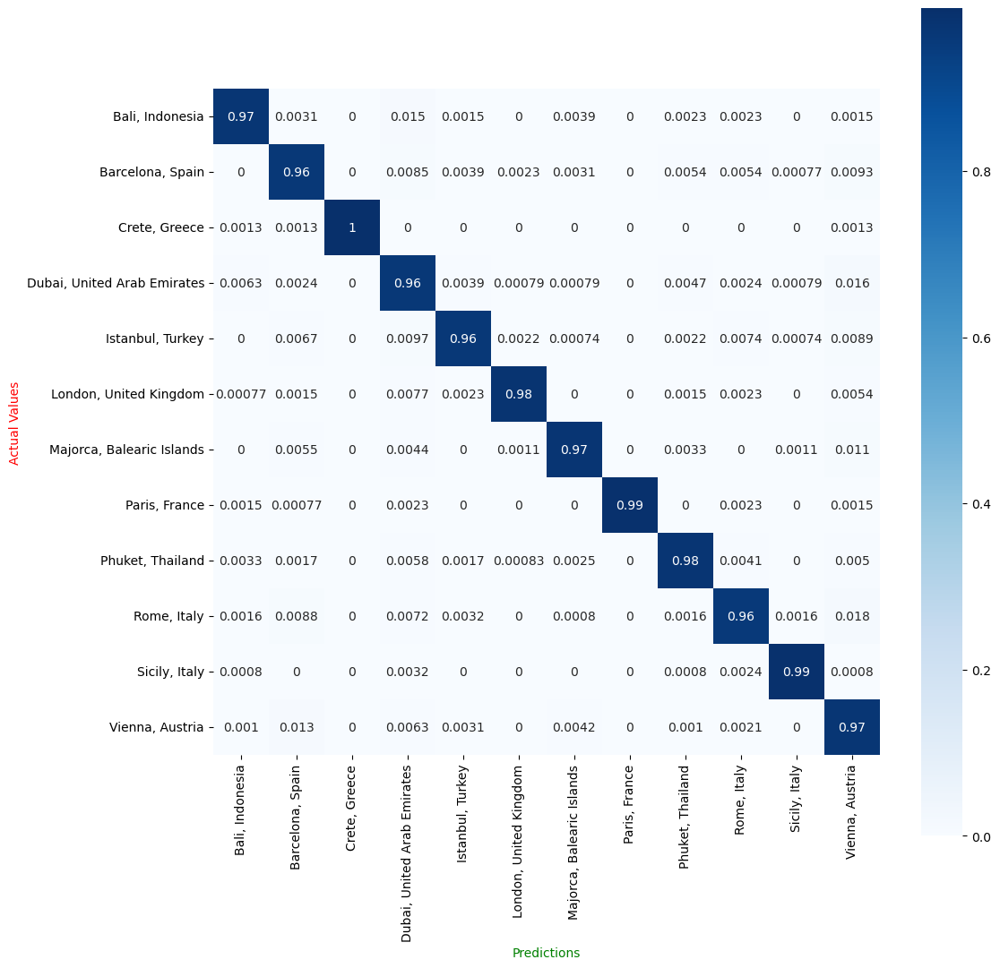

Test Confusion Matrix



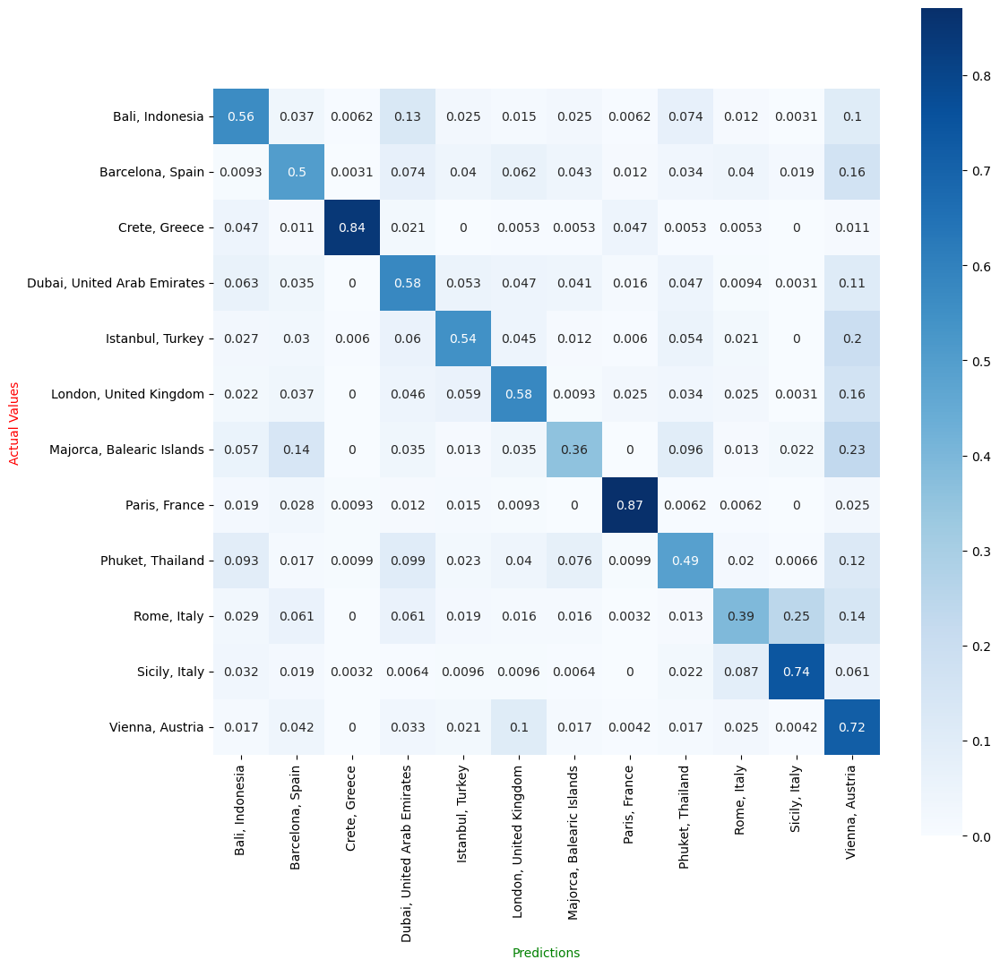


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.61      0.56      0.58       324
           Barcelona, Spain       0.56      0.50      0.53       324
              Crete, Greece       0.93      0.84      0.88       190
Dubai, United Arab Emirates       0.51      0.58      0.54       318
           Istanbul, Turkey       0.68      0.54      0.60       336
     London, United Kingdom       0.63      0.58      0.60       324
  Majorca, Balearic Islands       0.52      0.36      0.42       228
              Paris, France       0.89      0.87      0.88       324
           Phuket, Thailand       0.55      0.49      0.52       302
                Rome, Italy       0.60      0.39      0.47       312
              Sicily, Italy       0.71      0.74      0.73       312
            Vienna, Austria       0.30      0.72      0.42       240

                   accuracy                           0.59      3534
             

In [91]:
evaluate_model(rf, X_train_tfidf, X_test_tfidf)

In [92]:
#Getting feature importances

feature_rel = pd.Series(rf.feature_importances_, index=vectorizer.get_feature_names_out())
feature_rel[0:22]

ab            2.776232e-05
abaco         1.155412e-04
abadi         6.147928e-06
abandon       3.917860e-06
abanic        3.240036e-05
abate         5.232669e-05
abbasağa      1.443627e-18
abbazia       1.687473e-05
abbey         4.833924e-05
abbot         2.788402e-05
abbott        3.725082e-05
abc           2.187443e-05
abdel         3.342435e-05
abdi          0.000000e+00
abdulazeez    2.348981e-05
abdulkadir    7.488357e-07
abdullah      6.722219e-05
abdulvedud    9.066768e-20
abe           5.393990e-06
abeer         2.811969e-05
abelló        1.792945e-05
abeln         2.705368e-05
dtype: float64

In [93]:
top_20 = feature_rel.sort_values(ascending=False).head(22)
top_20

tour         0.016738
di           0.012824
heraklion    0.011181
chania       0.010055
tourism      0.008719
chiesa       0.006681
massage      0.006150
de           0.005489
driver       0.005183
spa          0.004723
roma         0.004155
rethymno     0.003974
travel       0.003945
day          0.003931
guide        0.003833
desert       0.003413
museo        0.003174
louvre       0.003036
palazzo      0.003030
sitia        0.003028
del          0.002929
wien         0.002916
dtype: float64

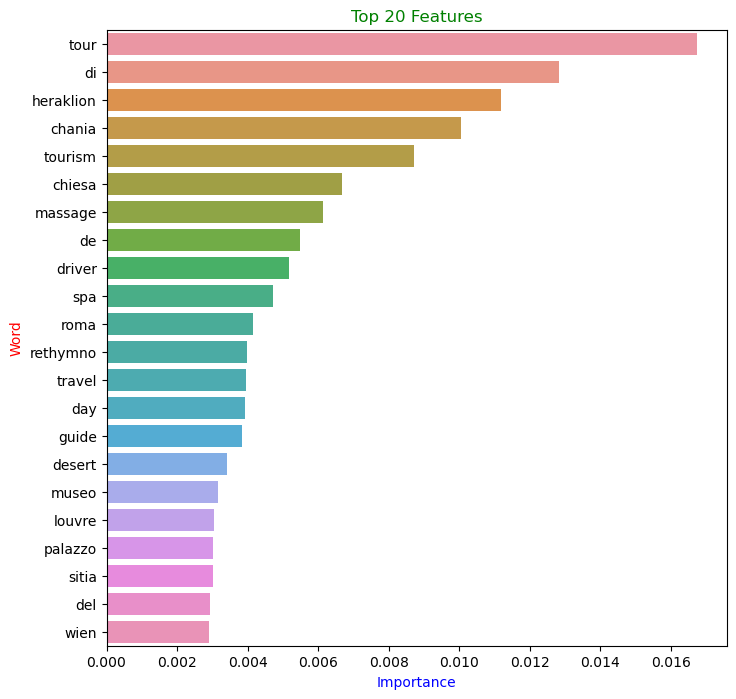

In [94]:
plt.figure(figsize=(8,8))
sns.barplot(x=top_20, y=top_20.index)
plt.title('Top 20 Features', color="Green")
plt.ylabel('Word', color="Red")
plt.xlabel('Importance', color='blue')
plt.show()

This model still does not perform very well with the test set. 

Interestingly, the feature importances show a lot of city-specific words, such as 'eiffel'-- the name of a tower in Paris. 

In the future, it might be a good idea to take these kinds of words out, but for the model's use-case we can leave them in for now.

This model's performance is very good, but random forests have 2 major flaws that will affect this model for its specific use-case:

1. They are more computationally expensive than Naive Bayes models (AKA they take longer to train and predict)

2. They use a greedy algorithm, meaning they often favor the bigger class

Thus, iteration 3 remains the best model so far.

### Trying the iteration 3 without lemmatization

Using the cleaned text data without lemmatizing it.

In [95]:
X_train_cleaned = preprocess_df(pd.DataFrame(X_train, columns=['Attraction']),
                                'cleaned', lemmatize=False)
X_test_cleaned = preprocess_df(pd.DataFrame(X_test, columns=['Attraction']),
                               'cleaned', lemmatize=False)

,Attraction,cleaned
308,"The Best of Paris Food Tour, EXPLORE FOOD TOURS.",the best of paris food tour explore food tours
331,Vienna Airport Cab,vienna airport cab
1372,Olgiata Golf Club,olgiata golf club
1261,Beauty Nail Concept,beauty nail concept
1162,Galeri Kayseri,galeri kayseri
1060,E-Bike City Tour in Paris,ebike city tour in paris
1559,Koala 2.0 Industry Aps,koala industry aps
996,Mushrif Cliff,mushrif cliff
514,Mallorca Top Charters,mallorca top charters
1169,Teatro Selinus,teatro selinus


,Attraction,cleaned
1574,Istanbul Jewish Tours - Day Tours,istanbul jewish tours day tours
618,Saba Bali Trans - Day Tours,saba bali trans day tours
402,Romantic Sailing,romantic sailing
152,Twilight Sea Canoe Phuket,twilight sea canoe phuket
17,Monastero dei Benedettini,monastero dei benedettini
183,Etna 'Ngeniousa,etna ngeniousa
1412,Paris: Private Pastry Food Tour of French Swee...,paris private pastry food tour of french sweet...
229,GoCar GPS Guided Tours,gocar gps guided tours
1037,Magda Danysz Gallery,magda danysz gallery
17,Private Rethymno Oil and Honey Tasting Pottery...,private rethymno oil and honey tasting pottery...


In [96]:
vectorizer = TfidfVectorizer(analyzer='word',stop_words=new_stopwords, decode_error='ignore')
X_train_tfidf = vectorizer.fit_transform(X_train_cleaned['cleaned'])
X_test_tfidf = vectorizer.transform(X_test_cleaned['cleaned'])

In [97]:
nb_cleaned = MultinomialNB()
nb_cleaned.fit(X_train_tfidf,
       y_train,
       sample_weight=sample_weights)

MultinomialNB()

Training Accuracy: 0.8438517051082496
Testing Accuracy: 0.608375778155065

---------------

Training F1: 0.8430052878481237
Testing F1: 0.6068666977483838

---------------

Train Confusion Matrix



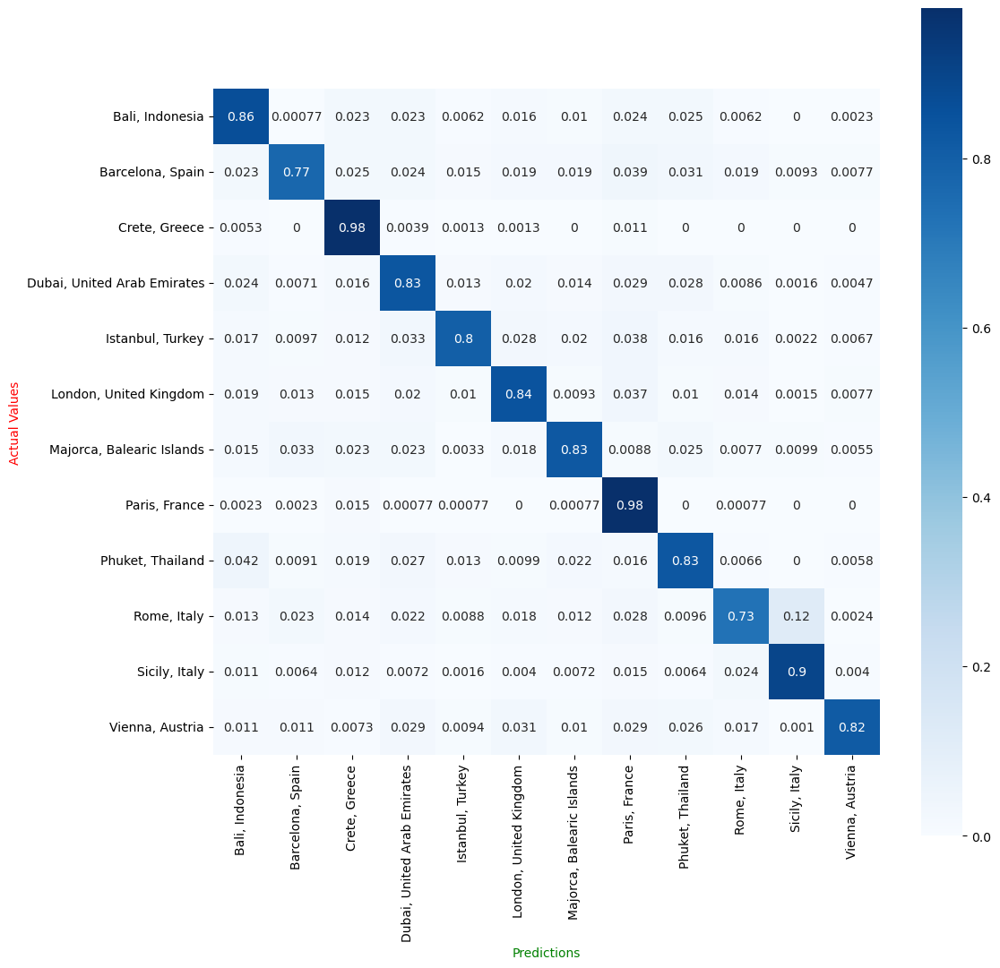

Test Confusion Matrix



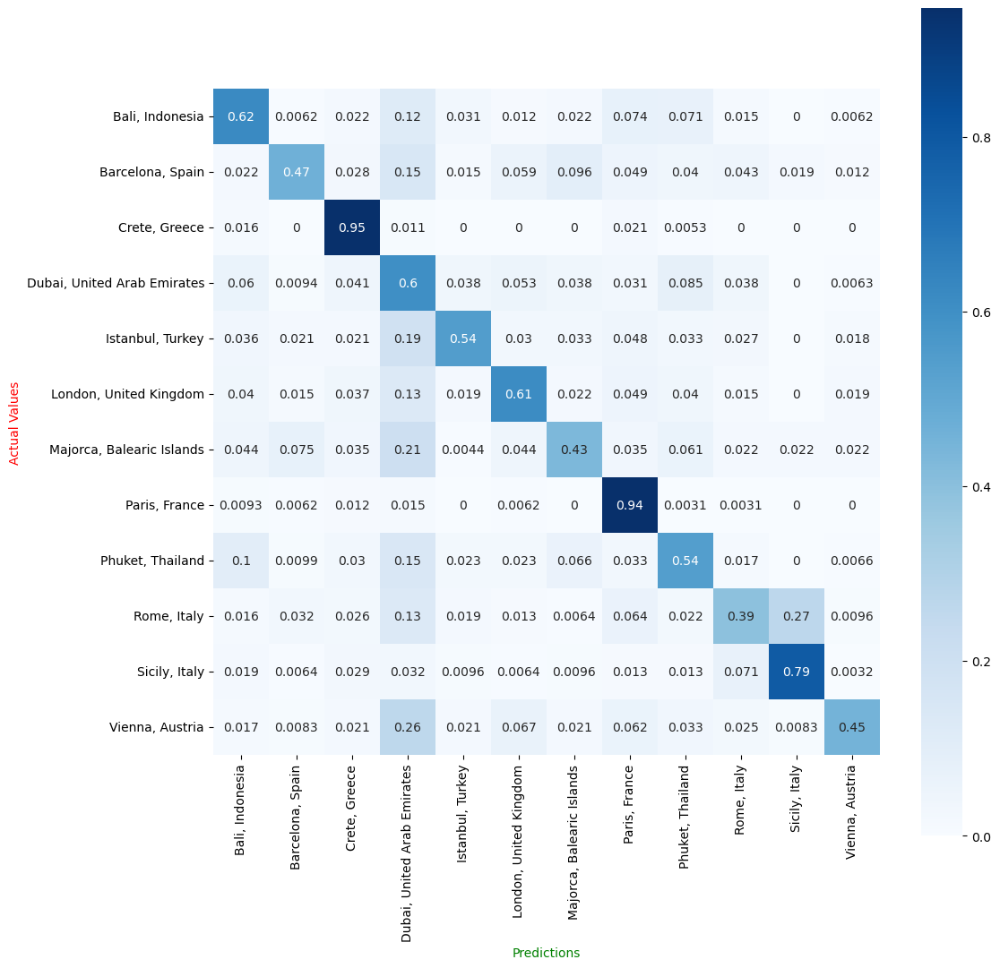


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.64      0.62      0.63       324
           Barcelona, Spain       0.74      0.47      0.57       324
              Crete, Greece       0.66      0.95      0.78       190
Dubai, United Arab Emirates       0.32      0.60      0.42       318
           Istanbul, Turkey       0.77      0.54      0.64       336
     London, United Kingdom       0.69      0.61      0.65       324
  Majorca, Balearic Islands       0.50      0.43      0.46       228
              Paris, France       0.68      0.94      0.79       324
           Phuket, Thailand       0.57      0.54      0.56       302
                Rome, Italy       0.59      0.39      0.47       312
              Sicily, Italy       0.72      0.79      0.75       312
            Vienna, Austria       0.78      0.45      0.57       240

                   accuracy                           0.61      3534
             

In [98]:
evaluate_model(nb_cleaned, X_train_tfidf, X_test_tfidf)

Ultimately, this model performs very similar to the lemmatized version of it. 

There are some small differences that contribute to choosing this version as the final model:

1. The test accuracy and F1 scores are a bit higher for this model compared to the lemmatized version. 

2. Lemmatization version is more computationally expensive than getting rid of the lemmatization.

Therefore, the final model is iteration 3 (Naive Bayes) without lemmatizing the text.

In [99]:
# Saving the best Naive Bayes Model
joblib.dump(nb_cleaned, '/Users/lianaavagyan/Desktop/capstone/non_lemmatized_model')

['/Users/lianaavagyan/Desktop/capstone/non_lemmatized_model']

# Testing out the model

Using this model to tell people where they need to travel to based on what they want to do during their vacation.

Looking at some predictions this model gives them, using iteration 3 as the final model.

In [100]:
def preprocess_text(text):
    
    preprocessed = text.lower()
    preprocessed = re.sub('[%s]' % re.escape(string.punctuation), '', preprocessed)
    preprocessed = re.sub('\w*\d\w*','', preprocessed)
        
    return [preprocessed]

### Testing out some real examples

In [101]:
raw_text = 'I want to go to beach, enjoy hiking and swimming'
preprocessed_text = preprocess_text(raw_text)
preprocessed_text

['i want to go to beach enjoy hiking and swimming']

In [102]:
nb_cleaned.predict(vectorizer.transform(preprocessed_text))

array(['Crete, Greece'], dtype='<U27')

In [103]:
preprocessed2 = preprocess_text('Historical museums, towers, luxurious restaurants')
print(preprocessed2)
nb_cleaned.predict(vectorizer.transform(preprocessed2))

['historical museums towers luxurious restaurants']


array(['Paris, France'], dtype='<U27')

In [104]:
preprocessed3 = preprocess_text('Drink wine, go for long walks and have tasty ice cream')
print(preprocessed3)
nb_cleaned.predict(vectorizer.transform(preprocessed3))

['drink wine go for long walks and have tasty ice cream']


array(['London, United Kingdom'], dtype='<U27')

In [105]:
preprocessed4 = preprocess_text('Do yoga on the beach and relax, visit and pray in churches')
print(preprocessed4)
nb_cleaned.predict(vectorizer.transform(preprocessed4))

['do yoga on the beach and relax visit and pray in churches']


array(['Phuket, Thailand'], dtype='<U27')

### Creating the pipeline of the process

In [110]:
class PreprocessText(TransformerMixin):
    
    def __init__(self):
        self = self
    
    def fit(self, X, y=None, **fit_params):
        return self
        
    def transform(self, X, **transform_params):
        try:
            X = pd.DataFrame(X, columns=['Attraction'])
            X['cleaned'] = X['Attraction'].apply(lambda x: x.lower())
            X['cleaned'] = X['cleaned'].apply(lambda x: re.sub('[%s]' % re.escape(string.punctuation), '', x))
            X['cleaned'] = X['cleaned'].apply(lambda x: re.sub('\w*\d\w*','', x))
            
            X = X['cleaned']
        except:
            pass
        return X
    
class DenseTransformer():

    def __init__(self):
        self = self
    
    def fit(self, X, y=None, **fit_params):
        return self

    def transform(self, X, y=None, **fit_params):
        return X

In [111]:
# Testing preprocessing class

prep = PreprocessText()
prep.transform(X_train)

308        the best of paris food tour explore food tours
331                                    vienna airport cab
1372                                    olgiata golf club
1261                                  beauty nail concept
1162                                       galeri kayseri
                              ...                        
356      snorkeling experience in kourtaliotiko gorge ...
1541                                            muse artz
1469                                        talixo  dubai
1105                                  metamarkt flohmarkt
1454                                     the cut bcn club
Name: cleaned, Length: 14134, dtype: object

In [112]:
pip = Pipeline(steps=[
                ('TextPreprocessor', PreprocessText()),
                ('TFIDFVectorizer', TfidfVectorizer(analyzer='word',
                                                    stop_words=new_stopwords,
                                                    decode_error='ignore')),
                ('DenseTransformer', DenseTransformer()),
                ('NaiveBayes', MultinomialNB())])

In [113]:
set_config(display='diagram')

In [114]:
pip.fit(X_train,
         y_train, 
         **{'NaiveBayes__sample_weight': sample_weights})

Pipeline(steps=[('TextPreprocessor',
                 <__main__.PreprocessText object at 0x1669aa650>),
                ('TFIDFVectorizer',
                 TfidfVectorizer(decode_error='ignore',
                                 stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...])),
                ('DenseTransformer',
                 <__main__.DenseTransformer object at 0x16c02e750>),
                ('NaiveBayes', MultinomialNB())])

In [115]:
pip.score(X_test, y_test)

0.608375778155065

In [116]:
pip.predict(['We want to go surfing and get a tan while sleeping on the beach'])

array(['Bali, Indonesia'], dtype='<U27')

In [117]:
pip.predict(['Go out for alcoholic drinks and parties'])

array(['Majorca, Balearic Islands'], dtype='<U27')

In [118]:
def evaluate_pip(pip, X_train, X_test):
    
    y_preds_train = pip.predict(X_train)
    y_preds_test = pip.predict(X_test)

    print('Training Accuracy:', accuracy_score(y_train, y_preds_train))
    print('Testing Accuracy:', accuracy_score(y_test, y_preds_test))
    print('\n---------------\n')
    print('Training F1:', f1_score(y_train, y_preds_train, average='weighted'))
    print('Testing F1:', f1_score(y_test, y_preds_test, average='weighted'))
    print('\n---------------\n')
    print('Train Confusion Matrix\n')
    conf_matrix(y_train, y_preds_train)
    print('Test Confusion Matrix\n')
    conf_matrix(y_test, y_preds_test)
    print('\n----------------\n')
    print(classification_report(y_test, y_preds_test))

Training Accuracy: 0.8438517051082496
Testing Accuracy: 0.608375778155065

---------------

Training F1: 0.8430052878481237
Testing F1: 0.6068666977483838

---------------

Train Confusion Matrix



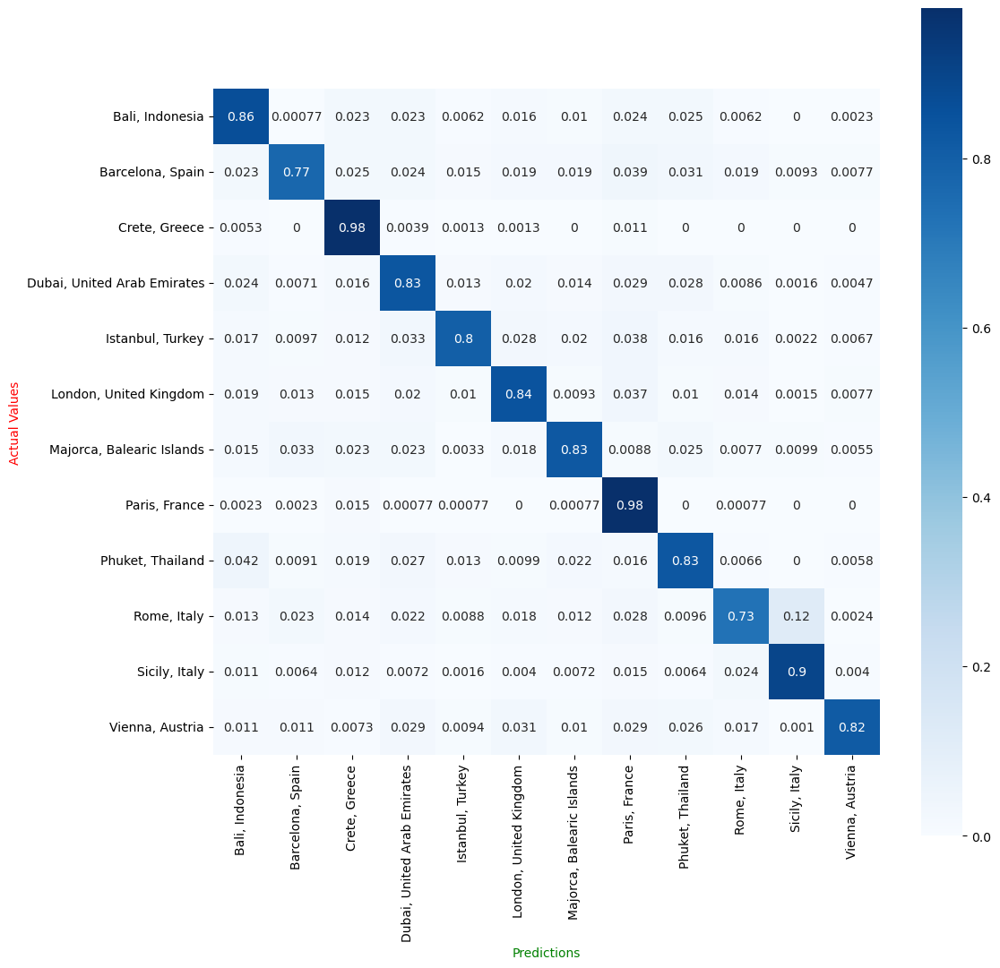

Test Confusion Matrix



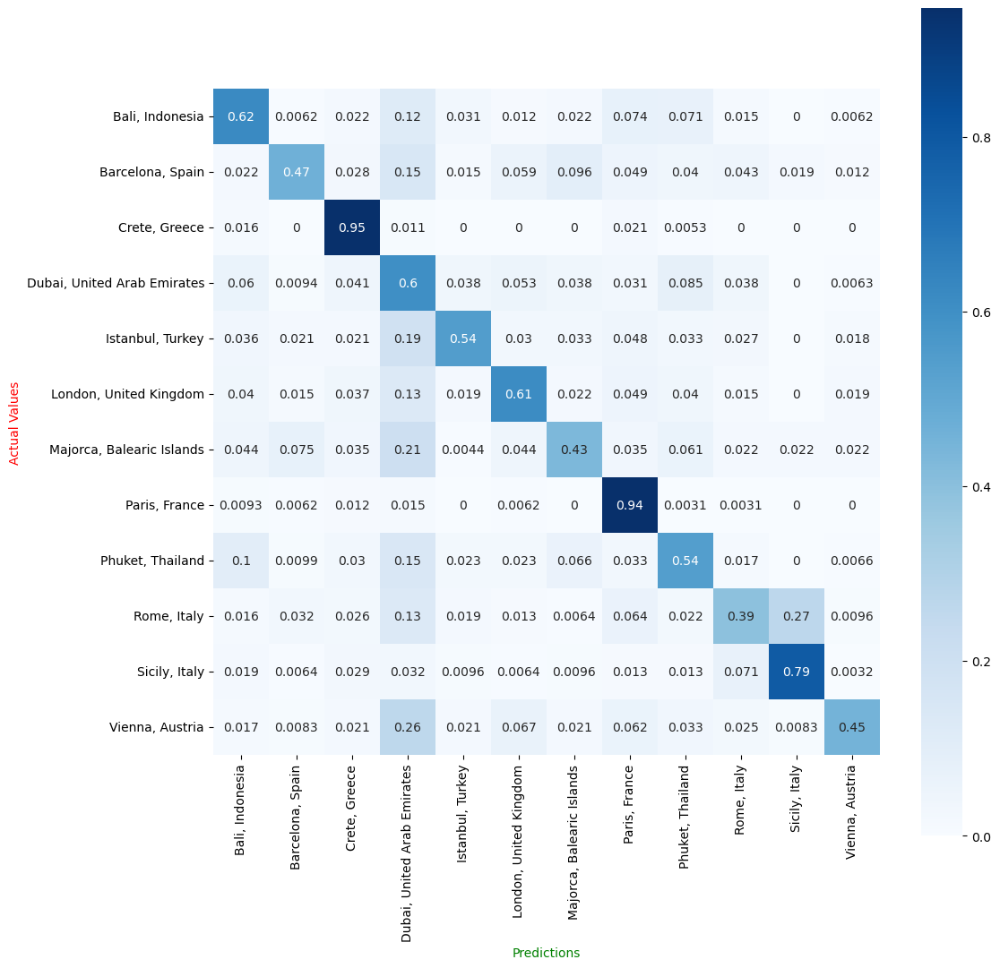


----------------

                             precision    recall  f1-score   support

            Bali, Indonesia       0.64      0.62      0.63       324
           Barcelona, Spain       0.74      0.47      0.57       324
              Crete, Greece       0.66      0.95      0.78       190
Dubai, United Arab Emirates       0.32      0.60      0.42       318
           Istanbul, Turkey       0.77      0.54      0.64       336
     London, United Kingdom       0.69      0.61      0.65       324
  Majorca, Balearic Islands       0.50      0.43      0.46       228
              Paris, France       0.68      0.94      0.79       324
           Phuket, Thailand       0.57      0.54      0.56       302
                Rome, Italy       0.59      0.39      0.47       312
              Sicily, Italy       0.72      0.79      0.75       312
            Vienna, Austria       0.78      0.45      0.57       240

                   accuracy                           0.61      3534
             

In [119]:
evaluate_pip(pip, X_train, X_test)

In [120]:
# Saving the Pipeline
joblib.dump(pip, '/Users/lianaavagyan/Desktop/capstone/final_pip')

['/Users/lianaavagyan/Desktop/capstone/final_pip']

In [121]:
# Loading pip from joblib file to test

best_pip = joblib.load('/Users/lianaavagyan/Desktop/capstone/final_pip')
best_pip

Pipeline(steps=[('TextPreprocessor',
                 <__main__.PreprocessText object at 0x166e472d0>),
                ('TFIDFVectorizer',
                 TfidfVectorizer(decode_error='ignore',
                                 stop_words=['i', 'me', 'my', 'myself', 'we',
                                             'our', 'ours', 'ourselves', 'you',
                                             "you're", "you've", "you'll",
                                             "you'd", 'your', 'yours',
                                             'yourself', 'yourselves', 'he',
                                             'him', 'his', 'himself', 'she',
                                             "she's", 'her', 'hers', 'herself',
                                             'it', "it's", 'its', 'itself', ...])),
                ('DenseTransformer',
                 <__main__.DenseTransformer object at 0x1671392d0>),
                ('NaiveBayes', MultinomialNB())])

In [122]:
best_pip.predict(['I want to visit museeums and art galleries'])

array(['Paris, France'], dtype='<U27')

We conclude that the Naive Bayes iteration 3 without lemmatization is the best model.

The final model is a Multinomial Naive Bayes classifier.

This can predict a destination with 60% accuracy and around 60% F1 score (iteration 3 without lemmatization). 

The text data put into this model is not lemmatized, but is lowercased with stopwords removed and city names removed.